In [1]:
import ccxt
import numpy as np
import pandas as pd
import datetime as dt
from dateutil import tz
import matplotlib.pyplot as plt

import json
import time
import os
import sys

In [2]:
src_path = '../src/'
sys.path.append(os.path.abspath(src_path))
from func_get import *
from func_signal import *
from func_backtest import *

In [3]:
start_ts = time.time()

In [4]:
interval_dict = {
    '1m': 1,
    '5m': 5,
    '15m': 15,
    '30m': 30,
    '1h': 60,
    '2h': 120,
    '4h': 240,
    '1d': 1440
}

In [5]:
with open('../../../_keys/ftx/ftx_read_keys.json') as keys_file:
    keys_dict = json.load(keys_file)
    
exchange = ccxt.ftx({'apiKey': keys_dict['apiKey'],
                     'secret': keys_dict['secret'],
                     'enableRateLimit': True})

### Config

In [6]:
project_name = 'cryptoris_no-ema'

In [7]:
start_date = dt.datetime(2021, 1, 1)
start_hour = 0
end_date = dt.datetime.today() - dt.timedelta(days=1)
reinvest_profit_flag = True

In [8]:
config_params = {
    'safety_ohlcv_range': 1000,
    'action_timeframe': '15m',
    'base': {
        'symbol': ['ETH-PERP', 'SOL-PERP', 'LUNA-PERP'],
        'open': {
            '15m': {
                'supertrend': {
                    'check': [check_signal_side_change],
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }
            },
            '1h': {
                'supertrend': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }        
            }    
            
        },
        'close': {
            '15m': {
                'supertrend': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }    
            }
        }
    },
    'lead': {
        'symbol': ['BTC-PERP'],
        'open': {
            '15m': {
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }
            }
        },
        'close': {
        }
    },
    'tp': {
        'price_percent': 5,
        'signal': None,
    },
    'sl': {
        'price_percent': None,
        'signal': {
            'timeframe': '15m',
            'signal': {
                'supertrend': {
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                }
            }
        }
    },
    'action_percent': 0.1,
    'leverage': 5,
    'taker_fee': 0.07
}

### Get data

In [9]:
ohlcv_df_dict = get_data(exchange, start_date, end_date, start_hour, interval_dict, config_params)

base: timeframe 1/2 symbol 1/3 date 1/432
base: timeframe 1/2 symbol 1/3 date 2/432
base: timeframe 1/2 symbol 1/3 date 3/432
base: timeframe 1/2 symbol 1/3 date 4/432
base: timeframe 1/2 symbol 1/3 date 5/432
base: timeframe 1/2 symbol 1/3 date 6/432
base: timeframe 1/2 symbol 1/3 date 7/432
base: timeframe 1/2 symbol 1/3 date 8/432
base: timeframe 1/2 symbol 1/3 date 9/432
base: timeframe 1/2 symbol 1/3 date 10/432
base: timeframe 1/2 symbol 1/3 date 11/432
base: timeframe 1/2 symbol 1/3 date 12/432
base: timeframe 1/2 symbol 1/3 date 13/432
base: timeframe 1/2 symbol 1/3 date 14/432
base: timeframe 1/2 symbol 1/3 date 15/432
base: timeframe 1/2 symbol 1/3 date 16/432
base: timeframe 1/2 symbol 1/3 date 17/432
base: timeframe 1/2 symbol 1/3 date 18/432
base: timeframe 1/2 symbol 1/3 date 19/432
base: timeframe 1/2 symbol 1/3 date 20/432
base: timeframe 1/2 symbol 1/3 date 21/432
base: timeframe 1/2 symbol 1/3 date 22/432
base: timeframe 1/2 symbol 1/3 date 23/432
base: timeframe 1/2 

base: timeframe 1/2 symbol 1/3 date 190/432
base: timeframe 1/2 symbol 1/3 date 191/432
base: timeframe 1/2 symbol 1/3 date 192/432
base: timeframe 1/2 symbol 1/3 date 193/432
base: timeframe 1/2 symbol 1/3 date 194/432
base: timeframe 1/2 symbol 1/3 date 195/432
base: timeframe 1/2 symbol 1/3 date 196/432
base: timeframe 1/2 symbol 1/3 date 197/432
base: timeframe 1/2 symbol 1/3 date 198/432
base: timeframe 1/2 symbol 1/3 date 199/432
base: timeframe 1/2 symbol 1/3 date 200/432
base: timeframe 1/2 symbol 1/3 date 201/432
base: timeframe 1/2 symbol 1/3 date 202/432
base: timeframe 1/2 symbol 1/3 date 203/432
base: timeframe 1/2 symbol 1/3 date 204/432
base: timeframe 1/2 symbol 1/3 date 205/432
base: timeframe 1/2 symbol 1/3 date 206/432
base: timeframe 1/2 symbol 1/3 date 207/432
base: timeframe 1/2 symbol 1/3 date 208/432
base: timeframe 1/2 symbol 1/3 date 209/432
base: timeframe 1/2 symbol 1/3 date 210/432
base: timeframe 1/2 symbol 1/3 date 211/432
base: timeframe 1/2 symbol 1/3 d

base: timeframe 1/2 symbol 1/3 date 378/432
base: timeframe 1/2 symbol 1/3 date 379/432
base: timeframe 1/2 symbol 1/3 date 380/432
base: timeframe 1/2 symbol 1/3 date 381/432
base: timeframe 1/2 symbol 1/3 date 382/432
base: timeframe 1/2 symbol 1/3 date 383/432
base: timeframe 1/2 symbol 1/3 date 384/432
base: timeframe 1/2 symbol 1/3 date 385/432
base: timeframe 1/2 symbol 1/3 date 386/432
base: timeframe 1/2 symbol 1/3 date 387/432
base: timeframe 1/2 symbol 1/3 date 388/432
base: timeframe 1/2 symbol 1/3 date 389/432
base: timeframe 1/2 symbol 1/3 date 390/432
base: timeframe 1/2 symbol 1/3 date 391/432
base: timeframe 1/2 symbol 1/3 date 392/432
base: timeframe 1/2 symbol 1/3 date 393/432
base: timeframe 1/2 symbol 1/3 date 394/432
base: timeframe 1/2 symbol 1/3 date 395/432
base: timeframe 1/2 symbol 1/3 date 396/432
base: timeframe 1/2 symbol 1/3 date 397/432
base: timeframe 1/2 symbol 1/3 date 398/432
base: timeframe 1/2 symbol 1/3 date 399/432
base: timeframe 1/2 symbol 1/3 d

base: timeframe 1/2 symbol 2/3 date 135/432
base: timeframe 1/2 symbol 2/3 date 136/432
base: timeframe 1/2 symbol 2/3 date 137/432
base: timeframe 1/2 symbol 2/3 date 138/432
base: timeframe 1/2 symbol 2/3 date 139/432
base: timeframe 1/2 symbol 2/3 date 140/432
base: timeframe 1/2 symbol 2/3 date 141/432
base: timeframe 1/2 symbol 2/3 date 142/432
base: timeframe 1/2 symbol 2/3 date 143/432
base: timeframe 1/2 symbol 2/3 date 144/432
base: timeframe 1/2 symbol 2/3 date 145/432
base: timeframe 1/2 symbol 2/3 date 146/432
base: timeframe 1/2 symbol 2/3 date 147/432
base: timeframe 1/2 symbol 2/3 date 148/432
base: timeframe 1/2 symbol 2/3 date 149/432
base: timeframe 1/2 symbol 2/3 date 150/432
base: timeframe 1/2 symbol 2/3 date 151/432
base: timeframe 1/2 symbol 2/3 date 152/432
base: timeframe 1/2 symbol 2/3 date 153/432
base: timeframe 1/2 symbol 2/3 date 154/432
base: timeframe 1/2 symbol 2/3 date 155/432
base: timeframe 1/2 symbol 2/3 date 156/432
base: timeframe 1/2 symbol 2/3 d

base: timeframe 1/2 symbol 2/3 date 322/432
base: timeframe 1/2 symbol 2/3 date 323/432
base: timeframe 1/2 symbol 2/3 date 324/432
base: timeframe 1/2 symbol 2/3 date 325/432
base: timeframe 1/2 symbol 2/3 date 326/432
base: timeframe 1/2 symbol 2/3 date 327/432
base: timeframe 1/2 symbol 2/3 date 328/432
base: timeframe 1/2 symbol 2/3 date 329/432
base: timeframe 1/2 symbol 2/3 date 330/432
base: timeframe 1/2 symbol 2/3 date 331/432
base: timeframe 1/2 symbol 2/3 date 332/432
base: timeframe 1/2 symbol 2/3 date 333/432
base: timeframe 1/2 symbol 2/3 date 334/432
base: timeframe 1/2 symbol 2/3 date 335/432
base: timeframe 1/2 symbol 2/3 date 336/432
base: timeframe 1/2 symbol 2/3 date 337/432
base: timeframe 1/2 symbol 2/3 date 338/432
base: timeframe 1/2 symbol 2/3 date 339/432
base: timeframe 1/2 symbol 2/3 date 340/432
base: timeframe 1/2 symbol 2/3 date 341/432
base: timeframe 1/2 symbol 2/3 date 342/432
base: timeframe 1/2 symbol 2/3 date 343/432
base: timeframe 1/2 symbol 2/3 d

base: timeframe 1/2 symbol 3/3 date 79/432
base: timeframe 1/2 symbol 3/3 date 80/432
base: timeframe 1/2 symbol 3/3 date 81/432
base: timeframe 1/2 symbol 3/3 date 82/432
base: timeframe 1/2 symbol 3/3 date 83/432
base: timeframe 1/2 symbol 3/3 date 84/432
base: timeframe 1/2 symbol 3/3 date 85/432
base: timeframe 1/2 symbol 3/3 date 86/432
base: timeframe 1/2 symbol 3/3 date 87/432
base: timeframe 1/2 symbol 3/3 date 88/432
base: timeframe 1/2 symbol 3/3 date 89/432
base: timeframe 1/2 symbol 3/3 date 90/432
base: timeframe 1/2 symbol 3/3 date 91/432
base: timeframe 1/2 symbol 3/3 date 92/432
base: timeframe 1/2 symbol 3/3 date 93/432
base: timeframe 1/2 symbol 3/3 date 94/432
base: timeframe 1/2 symbol 3/3 date 95/432
base: timeframe 1/2 symbol 3/3 date 96/432
base: timeframe 1/2 symbol 3/3 date 97/432
base: timeframe 1/2 symbol 3/3 date 98/432
base: timeframe 1/2 symbol 3/3 date 99/432
base: timeframe 1/2 symbol 3/3 date 100/432
base: timeframe 1/2 symbol 3/3 date 101/432
base: tim

base: timeframe 1/2 symbol 3/3 date 266/432
base: timeframe 1/2 symbol 3/3 date 267/432
base: timeframe 1/2 symbol 3/3 date 268/432
base: timeframe 1/2 symbol 3/3 date 269/432
base: timeframe 1/2 symbol 3/3 date 270/432
base: timeframe 1/2 symbol 3/3 date 271/432
base: timeframe 1/2 symbol 3/3 date 272/432
base: timeframe 1/2 symbol 3/3 date 273/432
base: timeframe 1/2 symbol 3/3 date 274/432
base: timeframe 1/2 symbol 3/3 date 275/432
base: timeframe 1/2 symbol 3/3 date 276/432
base: timeframe 1/2 symbol 3/3 date 277/432
base: timeframe 1/2 symbol 3/3 date 278/432
base: timeframe 1/2 symbol 3/3 date 279/432
base: timeframe 1/2 symbol 3/3 date 280/432
base: timeframe 1/2 symbol 3/3 date 281/432
base: timeframe 1/2 symbol 3/3 date 282/432
base: timeframe 1/2 symbol 3/3 date 283/432
base: timeframe 1/2 symbol 3/3 date 284/432
base: timeframe 1/2 symbol 3/3 date 285/432
base: timeframe 1/2 symbol 3/3 date 286/432
base: timeframe 1/2 symbol 3/3 date 287/432
base: timeframe 1/2 symbol 3/3 d

base: timeframe 2/2 symbol 1/3 date 22/463
base: timeframe 2/2 symbol 1/3 date 23/463
base: timeframe 2/2 symbol 1/3 date 24/463
base: timeframe 2/2 symbol 1/3 date 25/463
base: timeframe 2/2 symbol 1/3 date 26/463
base: timeframe 2/2 symbol 1/3 date 27/463
base: timeframe 2/2 symbol 1/3 date 28/463
base: timeframe 2/2 symbol 1/3 date 29/463
base: timeframe 2/2 symbol 1/3 date 30/463
base: timeframe 2/2 symbol 1/3 date 31/463
base: timeframe 2/2 symbol 1/3 date 32/463
base: timeframe 2/2 symbol 1/3 date 33/463
base: timeframe 2/2 symbol 1/3 date 34/463
base: timeframe 2/2 symbol 1/3 date 35/463
base: timeframe 2/2 symbol 1/3 date 36/463
base: timeframe 2/2 symbol 1/3 date 37/463
base: timeframe 2/2 symbol 1/3 date 38/463
base: timeframe 2/2 symbol 1/3 date 39/463
base: timeframe 2/2 symbol 1/3 date 40/463
base: timeframe 2/2 symbol 1/3 date 41/463
base: timeframe 2/2 symbol 1/3 date 42/463
base: timeframe 2/2 symbol 1/3 date 43/463
base: timeframe 2/2 symbol 1/3 date 44/463
base: timef

base: timeframe 2/2 symbol 1/3 date 210/463
base: timeframe 2/2 symbol 1/3 date 211/463
base: timeframe 2/2 symbol 1/3 date 212/463
base: timeframe 2/2 symbol 1/3 date 213/463
base: timeframe 2/2 symbol 1/3 date 214/463
base: timeframe 2/2 symbol 1/3 date 215/463
base: timeframe 2/2 symbol 1/3 date 216/463
base: timeframe 2/2 symbol 1/3 date 217/463
base: timeframe 2/2 symbol 1/3 date 218/463
base: timeframe 2/2 symbol 1/3 date 219/463
base: timeframe 2/2 symbol 1/3 date 220/463
base: timeframe 2/2 symbol 1/3 date 221/463
base: timeframe 2/2 symbol 1/3 date 222/463
base: timeframe 2/2 symbol 1/3 date 223/463
base: timeframe 2/2 symbol 1/3 date 224/463
base: timeframe 2/2 symbol 1/3 date 225/463
base: timeframe 2/2 symbol 1/3 date 226/463
base: timeframe 2/2 symbol 1/3 date 227/463
base: timeframe 2/2 symbol 1/3 date 228/463
base: timeframe 2/2 symbol 1/3 date 229/463
base: timeframe 2/2 symbol 1/3 date 230/463
base: timeframe 2/2 symbol 1/3 date 231/463
base: timeframe 2/2 symbol 1/3 d

base: timeframe 2/2 symbol 1/3 date 398/463
base: timeframe 2/2 symbol 1/3 date 399/463
base: timeframe 2/2 symbol 1/3 date 400/463
base: timeframe 2/2 symbol 1/3 date 401/463
base: timeframe 2/2 symbol 1/3 date 402/463
base: timeframe 2/2 symbol 1/3 date 403/463
base: timeframe 2/2 symbol 1/3 date 404/463
base: timeframe 2/2 symbol 1/3 date 405/463
base: timeframe 2/2 symbol 1/3 date 406/463
base: timeframe 2/2 symbol 1/3 date 407/463
base: timeframe 2/2 symbol 1/3 date 408/463
base: timeframe 2/2 symbol 1/3 date 409/463
base: timeframe 2/2 symbol 1/3 date 410/463
base: timeframe 2/2 symbol 1/3 date 411/463
base: timeframe 2/2 symbol 1/3 date 412/463
base: timeframe 2/2 symbol 1/3 date 413/463
base: timeframe 2/2 symbol 1/3 date 414/463
base: timeframe 2/2 symbol 1/3 date 415/463
base: timeframe 2/2 symbol 1/3 date 416/463
base: timeframe 2/2 symbol 1/3 date 417/463
base: timeframe 2/2 symbol 1/3 date 418/463
base: timeframe 2/2 symbol 1/3 date 419/463
base: timeframe 2/2 symbol 1/3 d

base: timeframe 2/2 symbol 2/3 date 125/463
base: timeframe 2/2 symbol 2/3 date 126/463
base: timeframe 2/2 symbol 2/3 date 127/463
base: timeframe 2/2 symbol 2/3 date 128/463
base: timeframe 2/2 symbol 2/3 date 129/463
base: timeframe 2/2 symbol 2/3 date 130/463
base: timeframe 2/2 symbol 2/3 date 131/463
base: timeframe 2/2 symbol 2/3 date 132/463
base: timeframe 2/2 symbol 2/3 date 133/463
base: timeframe 2/2 symbol 2/3 date 134/463
base: timeframe 2/2 symbol 2/3 date 135/463
base: timeframe 2/2 symbol 2/3 date 136/463
base: timeframe 2/2 symbol 2/3 date 137/463
base: timeframe 2/2 symbol 2/3 date 138/463
base: timeframe 2/2 symbol 2/3 date 139/463
base: timeframe 2/2 symbol 2/3 date 140/463
base: timeframe 2/2 symbol 2/3 date 141/463
base: timeframe 2/2 symbol 2/3 date 142/463
base: timeframe 2/2 symbol 2/3 date 143/463
base: timeframe 2/2 symbol 2/3 date 144/463
base: timeframe 2/2 symbol 2/3 date 145/463
base: timeframe 2/2 symbol 2/3 date 146/463
base: timeframe 2/2 symbol 2/3 d

base: timeframe 2/2 symbol 2/3 date 312/463
base: timeframe 2/2 symbol 2/3 date 313/463
base: timeframe 2/2 symbol 2/3 date 314/463
base: timeframe 2/2 symbol 2/3 date 315/463
base: timeframe 2/2 symbol 2/3 date 316/463
base: timeframe 2/2 symbol 2/3 date 317/463
base: timeframe 2/2 symbol 2/3 date 318/463
base: timeframe 2/2 symbol 2/3 date 319/463
base: timeframe 2/2 symbol 2/3 date 320/463
base: timeframe 2/2 symbol 2/3 date 321/463
base: timeframe 2/2 symbol 2/3 date 322/463
base: timeframe 2/2 symbol 2/3 date 323/463
base: timeframe 2/2 symbol 2/3 date 324/463
base: timeframe 2/2 symbol 2/3 date 325/463
base: timeframe 2/2 symbol 2/3 date 326/463
base: timeframe 2/2 symbol 2/3 date 327/463
base: timeframe 2/2 symbol 2/3 date 328/463
base: timeframe 2/2 symbol 2/3 date 329/463
base: timeframe 2/2 symbol 2/3 date 330/463
base: timeframe 2/2 symbol 2/3 date 331/463
base: timeframe 2/2 symbol 2/3 date 332/463
base: timeframe 2/2 symbol 2/3 date 333/463
base: timeframe 2/2 symbol 2/3 d

base: timeframe 2/2 symbol 3/3 date 37/463
base: timeframe 2/2 symbol 3/3 date 38/463
base: timeframe 2/2 symbol 3/3 date 39/463
base: timeframe 2/2 symbol 3/3 date 40/463
base: timeframe 2/2 symbol 3/3 date 41/463
base: timeframe 2/2 symbol 3/3 date 42/463
base: timeframe 2/2 symbol 3/3 date 43/463
base: timeframe 2/2 symbol 3/3 date 44/463
base: timeframe 2/2 symbol 3/3 date 45/463
base: timeframe 2/2 symbol 3/3 date 46/463
base: timeframe 2/2 symbol 3/3 date 47/463
base: timeframe 2/2 symbol 3/3 date 48/463
base: timeframe 2/2 symbol 3/3 date 49/463
base: timeframe 2/2 symbol 3/3 date 50/463
base: timeframe 2/2 symbol 3/3 date 51/463
base: timeframe 2/2 symbol 3/3 date 52/463
base: timeframe 2/2 symbol 3/3 date 53/463
base: timeframe 2/2 symbol 3/3 date 54/463
base: timeframe 2/2 symbol 3/3 date 55/463
base: timeframe 2/2 symbol 3/3 date 56/463
base: timeframe 2/2 symbol 3/3 date 57/463
base: timeframe 2/2 symbol 3/3 date 58/463
base: timeframe 2/2 symbol 3/3 date 59/463
base: timef

base: timeframe 2/2 symbol 3/3 date 225/463
base: timeframe 2/2 symbol 3/3 date 226/463
base: timeframe 2/2 symbol 3/3 date 227/463
base: timeframe 2/2 symbol 3/3 date 228/463
base: timeframe 2/2 symbol 3/3 date 229/463
base: timeframe 2/2 symbol 3/3 date 230/463
base: timeframe 2/2 symbol 3/3 date 231/463
base: timeframe 2/2 symbol 3/3 date 232/463
base: timeframe 2/2 symbol 3/3 date 233/463
base: timeframe 2/2 symbol 3/3 date 234/463
base: timeframe 2/2 symbol 3/3 date 235/463
base: timeframe 2/2 symbol 3/3 date 236/463
base: timeframe 2/2 symbol 3/3 date 237/463
base: timeframe 2/2 symbol 3/3 date 238/463
base: timeframe 2/2 symbol 3/3 date 239/463
base: timeframe 2/2 symbol 3/3 date 240/463
base: timeframe 2/2 symbol 3/3 date 241/463
base: timeframe 2/2 symbol 3/3 date 242/463
base: timeframe 2/2 symbol 3/3 date 243/463
base: timeframe 2/2 symbol 3/3 date 244/463
base: timeframe 2/2 symbol 3/3 date 245/463
base: timeframe 2/2 symbol 3/3 date 246/463
base: timeframe 2/2 symbol 3/3 d

base: timeframe 2/2 symbol 3/3 date 412/463
base: timeframe 2/2 symbol 3/3 date 413/463
base: timeframe 2/2 symbol 3/3 date 414/463
base: timeframe 2/2 symbol 3/3 date 415/463
base: timeframe 2/2 symbol 3/3 date 416/463
base: timeframe 2/2 symbol 3/3 date 417/463
base: timeframe 2/2 symbol 3/3 date 418/463
base: timeframe 2/2 symbol 3/3 date 419/463
base: timeframe 2/2 symbol 3/3 date 420/463
base: timeframe 2/2 symbol 3/3 date 421/463
base: timeframe 2/2 symbol 3/3 date 422/463
base: timeframe 2/2 symbol 3/3 date 423/463
base: timeframe 2/2 symbol 3/3 date 424/463
base: timeframe 2/2 symbol 3/3 date 425/463
base: timeframe 2/2 symbol 3/3 date 426/463
base: timeframe 2/2 symbol 3/3 date 427/463
base: timeframe 2/2 symbol 3/3 date 428/463
base: timeframe 2/2 symbol 3/3 date 429/463
base: timeframe 2/2 symbol 3/3 date 430/463
base: timeframe 2/2 symbol 3/3 date 431/463
base: timeframe 2/2 symbol 3/3 date 432/463
base: timeframe 2/2 symbol 3/3 date 433/463
base: timeframe 2/2 symbol 3/3 d

lead: timeframe 1/1 symbol 1/1 date 139/432
lead: timeframe 1/1 symbol 1/1 date 140/432
lead: timeframe 1/1 symbol 1/1 date 141/432
lead: timeframe 1/1 symbol 1/1 date 142/432
lead: timeframe 1/1 symbol 1/1 date 143/432
lead: timeframe 1/1 symbol 1/1 date 144/432
lead: timeframe 1/1 symbol 1/1 date 145/432
lead: timeframe 1/1 symbol 1/1 date 146/432
lead: timeframe 1/1 symbol 1/1 date 147/432
lead: timeframe 1/1 symbol 1/1 date 148/432
lead: timeframe 1/1 symbol 1/1 date 149/432
lead: timeframe 1/1 symbol 1/1 date 150/432
lead: timeframe 1/1 symbol 1/1 date 151/432
lead: timeframe 1/1 symbol 1/1 date 152/432
lead: timeframe 1/1 symbol 1/1 date 153/432
lead: timeframe 1/1 symbol 1/1 date 154/432
lead: timeframe 1/1 symbol 1/1 date 155/432
lead: timeframe 1/1 symbol 1/1 date 156/432
lead: timeframe 1/1 symbol 1/1 date 157/432
lead: timeframe 1/1 symbol 1/1 date 158/432
lead: timeframe 1/1 symbol 1/1 date 159/432
lead: timeframe 1/1 symbol 1/1 date 160/432
lead: timeframe 1/1 symbol 1/1 d

lead: timeframe 1/1 symbol 1/1 date 327/432
lead: timeframe 1/1 symbol 1/1 date 328/432
lead: timeframe 1/1 symbol 1/1 date 329/432
lead: timeframe 1/1 symbol 1/1 date 330/432
lead: timeframe 1/1 symbol 1/1 date 331/432
lead: timeframe 1/1 symbol 1/1 date 332/432
lead: timeframe 1/1 symbol 1/1 date 333/432
lead: timeframe 1/1 symbol 1/1 date 334/432
lead: timeframe 1/1 symbol 1/1 date 335/432
lead: timeframe 1/1 symbol 1/1 date 336/432
lead: timeframe 1/1 symbol 1/1 date 337/432
lead: timeframe 1/1 symbol 1/1 date 338/432
lead: timeframe 1/1 symbol 1/1 date 339/432
lead: timeframe 1/1 symbol 1/1 date 340/432
lead: timeframe 1/1 symbol 1/1 date 341/432
lead: timeframe 1/1 symbol 1/1 date 342/432
lead: timeframe 1/1 symbol 1/1 date 343/432
lead: timeframe 1/1 symbol 1/1 date 344/432
lead: timeframe 1/1 symbol 1/1 date 345/432
lead: timeframe 1/1 symbol 1/1 date 346/432
lead: timeframe 1/1 symbol 1/1 date 347/432
lead: timeframe 1/1 symbol 1/1 date 348/432
lead: timeframe 1/1 symbol 1/1 d

### Add signal

In [10]:
ohlcv_df_dict = add_signal(start_date, ohlcv_df_dict, interval_dict, config_params)

base add supertrend to ETH-PERP 15m
base add wt to ETH-PERP 15m
base add supertrend to SOL-PERP 15m
base add wt to SOL-PERP 15m
base add supertrend to LUNA-PERP 15m
base add wt to LUNA-PERP 15m
base add supertrend to ETH-PERP 1h
base add wt to ETH-PERP 1h
base add supertrend to SOL-PERP 1h
base add wt to SOL-PERP 1h
base add supertrend to LUNA-PERP 1h
base add wt to LUNA-PERP 1h
lead add wt to BTC-PERP 15m


### Back test

In [11]:
action_time_list = gen_action_time_list(config_params, ohlcv_df_dict)
max_open_timeframe = get_max_open_timeframe(config_params, interval_dict)

In [12]:
budget = 100

transaction_dict = {
    'symbol': [],
    'side': [],
    'amount': [],
    'open_time': [],
    'open_price': [],
    'close_time': [],
    'close_price': [],
    'notional': [],
    'profit': [],
    'profit_percent': []
}

position_dict = {}

if reinvest_profit_flag == True:
    budget_dict = {
        'time': [],
        'budget': []
    }
    
max_drawdown = 0

In [13]:
if reinvest_profit_flag == True:
    min_budget = budget

time_count = 0

for signal_time in action_time_list:
    action_time = signal_time + dt.timedelta(minutes=interval_dict[config_params['action_timeframe']])
    
    time_count += 1
    print(f"Time {action_time}: progress {time_count}/{len(action_time_list)}")

    '''
    Close positions
    '''
    for symbol in [x for x in position_dict.keys()]:
        print(f"  {symbol}")
        budget, max_drawdown, position_dict, transaction_dict = close_position(symbol, signal_time, max_drawdown, config_params, budget, reinvest_profit_flag, ohlcv_df_dict, position_dict, transaction_dict, interval_dict)

    '''
    Open positions
    '''
    max_position = int(1 / config_params['action_percent'])

    for symbol in [x for x in config_params['base']['symbol'] if x not in position_dict.keys()][:max_position]:
        print(f"  {symbol}")
        position_dict = open_position(symbol, signal_time, max_open_timeframe, config_params, budget, ohlcv_df_dict, position_dict, interval_dict)    
    
    '''
    Update budget
    '''
    if reinvest_profit_flag == True:
        budget_dict['time'].append(signal_time)
        budget_dict['budget'].append(budget)

        if budget < min_budget:
            min_budget = budget

    if budget <= 0:
        print(f"Out of money at {action_time}")
        break
        
'''
Clear final position
'''
opened_symbol = list(position_dict.keys())

for symbol in opened_symbol:
    print(f" Clear {symbol} position")
    
    side = position_dict[symbol]['side']
    ohlcv_df = ohlcv_df_dict['base'][config_params['action_timeframe']][symbol]
    current_ohlcv_df = ohlcv_df[ohlcv_df['time'] == signal_time].reset_index(drop=True)
    close_price = current_ohlcv_df.loc[0, 'close']
    
    budget, position_dict, transaction_dict = update_close_position(symbol, side, close_price, signal_time, config_params, budget, reinvest_profit_flag, position_dict, transaction_dict, interval_dict)

Time 2021-01-01 00:15:00: progress 1/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 00:30:00: progress 2/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 09:30:00: progress 38/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 09:45:00: progress 39/40416
  ETH-PERP
     base ETH-PERP che

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 19:45:00: progress 79/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 20:00:00: progress 80/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_si

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-02 07:15:00: progress 125/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-02 07:30:00: progress 126/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-02 17:30:00: progress 166/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-02 17:45:00: progress 167/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_ban

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-03 04:45:00: progress 211/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
    

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-03 14:30:00: progress 250/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PER

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 01:15:00: progress 293/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 01:30:00: progress 294/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 11:00:00: progress 332/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 21:45:00: progress 375/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy


     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-05 07:15:00: progress 413/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PER

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-05 17:45:00: progress 455/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP


     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 03:15:00: progress 493/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 03:30:00: progress 494/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 14:00:00: progress 536/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 14:15:00: progress 537/40416
 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 23:30:00: progress 574/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 23:45:00: progress 575/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-07 10:15:00: progress 617/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-07 20:15:00: progress 657/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
   

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-08 06:30:00: progress 698/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-08 06:45:00: progress 699/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-08 16:00:00: progress 736/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-08 16:15:00: progress 737/40416
  SOL-PERP
     Closed by tp at 2.4832500000000004
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band w

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 02:30:00: progress 778/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 02:45:00: progress 779/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1257.4517472795587
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ban

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3.1003366456367987
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 12:00:00: progress 816/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 22:30:00: progress 858/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     bas

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-10 07:45:00: progress 895/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action


     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-10 18:00:00: progress 936/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-11 03:30:00: progress 974/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-11 13:30:00: progress 1014/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sel

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-11 23:00:00: progress 1052/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP


     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-12 09:00:00: progress 1092/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h:

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-12 18:15:00: progress 1129/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-12 18:30:00: progress 1130/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PER

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-13 05:00:00: progress 1172/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PE

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-13 14:00:00: progress 1208/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_acti

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3.352900058026678
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-13 23:30:00: progress 1246/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-14 09:30:00: progress 1286/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PE

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-14 18:45:00: progress 1323/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3.3752602394473623
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-14 19:00:00: progress 1324/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 04:30:00: progress 1362/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 04:45:00: progress 1363/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 13:45:00: progress 1399/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 14:00:00: progress 1400/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 23:00:00: progress 1436/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-P

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-16 08:15:00: progress 1473/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-16 17:15:00: progress 1509/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PE

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 02:30:00: progress 1546/40416
  SOL-PERP
     Closed by tp at 3.633
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 02:45:00: progress 1547/40416
  ETH-PERP
     bas

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 12:00:00: progress 1584/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
   

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 21:15:00: progress 1621/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 21:30:00: progress 1622/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-18 07:45:00: progress 1663/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-18 08:00:00: progress 1664/40416
  

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-18 17:00:00: progress 1700/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-18 17:15:00: progress 1701/40416
  ETH-PERP
     base ETH-

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 03:00:00: progress 1740/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 03:15:00: progress 1741/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change su

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 12:00:00: progress 1776/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 12:15:00: progress 1777/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 21:45:00: progress 1815/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-20 06:45:00: progress 1851/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-20 07:00:00: progress 1852/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-20 16:15:00: progress 1889/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-21 01:15:00: progress 1925/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-21 01:30:00: progress 1926/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.04355137347842184
     price: 1322.6
     tp: 1256.4699999999998
     sl: 1375.3341754228431
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-21 10:45:00: progress 1963/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1368.3507578805588
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-21 20:30:00: progress 2002/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-22 05:45:00: progress 2039/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP


     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-22 15:00:00: progress 2076/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PE

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-23 00:00:00: progress 2112/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
   

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-23 09:15:00: progress 2149/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
   

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-23 18:45:00: progress 2187/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 04:30:00: progress 2226/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 0

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 13:45:00: progress 2263/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 14:00:00: progress 2264/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 23:15:00: progress 2301/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action


     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-25 08:15:00: progress 2337/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-25 08:30:00: progress 2338/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-25 17:45:00: progress 2375/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP


     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 02:45:00: progress 2411/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 03:00:00: progress 2412/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 12:00:00: progress 2448/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 21:15:00: progress 2485/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
 

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3.9148723022182104
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-27 06:45:00: progress 2523/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3.9331350719963893
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-27 16:00:00: progress 2560/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-27 16:15:00: progress 2561/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 01:00:00: progress 2596/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 01:15:00: progress 2597/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 10:15:00: progress 2633/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 10:30:00: progress 2634/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 19:30:00: progress 2670/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h:

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 04:30:00: progress 2706/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy


     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 13:30:00: progress 2742/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 13:45:00: progress 2743/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP che

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 22:30:00: progress 2778/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 22:45:00: progress 2779/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-30 07:30:00: progress 2814/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-30 07:45:00: progress 2815/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     bas

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-30 16:45:00: progress 2851/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-P

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 01:45:00: progress 2887/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 10:45:00: progress 2923/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 19:15:00: progress 2957/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 19:30:00: progress 2958/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_pri

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 04:00:00: progress 2992/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 04:15:00: progress 2993/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP ch

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 13:00:00: progress 3028/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     Update sl: 4.352119514962777
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 21:45:00: progress 3063/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 22:00:00: progress 3064/40416
  SOL-PERP
     base SOL-PERP check_signal_price su

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-02 07:15:00: progress 3101/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
   

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-02 16:00:00: progress 3136/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_acti

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-03 00:00:00: progress 3168/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: se

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-03 08:45:00: progress 3203/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-03 17:45:00: progress 3239/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-03 18:00:00: progress 3240/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-04 02:45:00: progress 3275/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-04 03:00:00: progress 3276/40416
  ETH-PERP
     base ETH-PERP check_signal_side_cha

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-04 11:15:00: progress 3309/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: se

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-04 18:45:00: progress 3339/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
   

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 03:45:00: progress 3375/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: sell
     Closed by signal at 6.0875
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: b

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 12:45:00: progress 3411/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 13:00:00: progress 3412/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP c

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 22:00:00: progress 3448/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action


     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-06 06:00:00: progress 3480/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-06 06:15:00: progress 3481/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-06 15:30:00: progress 3518/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sel

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-07 01:15:00: progress 3557/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action


     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-07 11:00:00: progress 3596/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-07 11:15:00: progress 3597/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP chec

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-07 20:45:00: progress 3635/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1648.867764400865
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
   

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-08 06:15:00: progress 3673/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_acti

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-08 15:45:00: progress 3711/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 01:15:00: progress 3749/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-P

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 10:45:00: progress 3787/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PER

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 20:15:00: progress 3825/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-P

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-10 05:30:00: progress 3862/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-10 05:45:00: progress 3863/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-10 15:00:00: progress 3900/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy


     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-11 00:30:00: progress 3938/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-11 09:45:00: progress 3975/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-11 19:15:00: progress 4013/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_act

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 04:30:00: progress 4050/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1812.2533659576177
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 04:45:00: progress 4051/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1810.883029361856
  SOL-PERP
     base SO

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 14:00:00: progress 4088/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 14:15:00: progress 4089/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 23:30:00: progress 4126/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 1769.7851491441409
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 23:45:00: progress 4127/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy


     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-13 09:00:00: progress 4164/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_act

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-13 18:30:00: progress 4202/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_acti

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-14 03:45:00: progress 4239/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h:

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-14 13:00:00: progress 4276/40416
  ETH-PERP
     Closed by sl at 1846.2474251087785
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-14 13:15:00: progress 4277/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-14 22:30:00: progress 4314/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1836.0454899194717
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 5.831684356598595
     price: 8.7925
     tp: 9.232125000000002
     sl: 8.5481647358596
  LUNA-PERP
     Not available data
Time 2021-02-14 22:45:00: progress 4315/4

     Update sl: 1819.4565086330151
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 08:45:00: progress 4355/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1799.4608577697138
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 09:00:00: progress 4356/40416
  ETH-PERP
    

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 18:15:00: progress 4393/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 03:30:00: progress 4430/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
   

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 13:00:00: progress 4468/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 1

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 22:15:00: progress 4505/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 22:30:00: progress 4506/40416
  ETH-PERP
     base ETH-PERP check_signal_side_cha

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 07:45:00: progress 4543/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 17:00:00: progress 4580/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 17:15:00: progress 4581

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 02:15:00: progress 4617/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 02:30:00: progress 4618/40416
  

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 11:30:00: progress 4654/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 11:45:00: progress 4655/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 20:45:00: progress 4691/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 21:00:00: progress 4692/40416
  

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-19 06:00:00: progress 4728/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-19 06:15:00: progress 4729/40416
  ETH-PERP
     base ETH-PERP check_signal_side_cha

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 8.989195266192148
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-19 14:30:00: progress 4762/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 9.013900739572934
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: 

     Update sl: 6.637249583911386
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-19 21:30:00: progress 4790/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.619724625097751
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-20 04:15:00: progress 4817/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-20 10:45:00: progress 4843/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-20 17:30:00: progress 4870/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-21 00:00:00: progress 4896/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-21 06:45:00: progress 4923/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-21 13:15:00: progress 4949/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-21 20:00:00: progress 4976/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-22 02:45:00: progress 5003/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-22 09:45:00: progress 5031/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-22 16:30:00: progress 5058/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-22 23:15:00: progress 5085/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-23 05:45:00: progress 5111/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-23 12:30:00: progress 5138/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 1

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-23 19:00:00: progress 5164/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-24 01:30:00: progress 5190/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-24 08:15:00: progress 5217/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-24 14:45:00: progress 5243/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-24 21:15:00: progress 5269/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-25 03:45:00: progress 5295/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-25 09:45:00: progress 5319/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-25 15:15:00: progress 5341/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     b

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-25 21:30:00: progress 5366/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BT

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-26 04:00:00: progress 5392/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 15.739154369145018
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-26 04:15:00: progress 5393/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertre

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-26 10:15:00: progress 5417/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-26 16:30:00: progress 5442/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-26 22:45:00: progress 5467/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-27 05:00:00: progress 5492/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1501.2325010728125
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-27 11:30:00: progress 5518/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-27 18:00:00: progress 5544/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-27 18:15:00: progress 5545/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     bas

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-28 01:15:00: progress 5573/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
    

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-02-28 08:15:00: progress 5601/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action


     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-28 14:45:00: progress 5627/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-02-28 21:15:00: progress 5653/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-01 03:45:00: progress 5679/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-01 10:00:00: progress 5704/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-01 16:30:00: progress 5730/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ba

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-01 23:00:00: progress 5756/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-02 05:30:00: progress 5782/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-02 11:45:00: progress 5807/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-02 18:15:00: progress 5833/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
   

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-03 01:00:00: progress 5860/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP che

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-03 07:45:00: progress 5887/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 6.373745963620172
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP che

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-03 14:15:00: progress 5913/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-03 20:45:00: progress 5939/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-04 03:00:00: progress 5964/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ba

     Update sl: 1571.8342897162008
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-04 09:30:00: progress 5990/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 1573.0508607445806
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-04 16:00:00: progress 6016/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-04 22:45:00: progress 6043/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_acti

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-05 05:15:00: progress 6069/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-05 11:30:00: progress 6094/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-05 18:00:00: progress 6120/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-06 00:15:00: progress 6145/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 12.793281512530427
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-06 00:30:00: progress 6146/4

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-06 07:00:00: progress 6172/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-06 13:30:00: progress 6198/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-06 19:45:00: progress 6223/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-07 02:15:00: progress 6249/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-07 08:45:00: progress 6275/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-07 15:00:00: progress 6300/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_pr

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-07 21:15:00: progress 6325/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ba

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-08 03:30:00: progress 6350/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-08 09:45:00: progress 6375/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-08 16:15:00: progress 6401/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_ba

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-08 22:30:00: progress 6426/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 1698.116692496742
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_cha

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-09 04:45:00: progress 6451/40416
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-09 11:00:00: progress 6476/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-09 17:15:00: progress 6501/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-09 23:30:00: progress 6526/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-10 06:00:00: progress 6552/40416
  ETH-PERP
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-10 12:00:00: progress 6576/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-10 18:15:00: progress 6601/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-11 00:45:00: progress 6627/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
  

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-11 07:15:00: progress 6653/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1843.7647683961957
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No ac

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-11 14:00:00: progress 6680/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-11 20:15:00: progress 6705/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-12 02:45:00: progress 6731/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 4.961951722704293
     price: 11.326
     tp: 11.8923
     sl: 10.724163040347298
Time 2021-03-12 09:15:00: progress 6757/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 10.85509673631257
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-12 15:30:00: progress 6782/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ba

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-12 21:45:00: progress 6807/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-13 04:00:00: progress 6832/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-13 04:15:00: progress 6833/40416
  ETH-PERP
     base ETH-PERP check_si

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-13 10:45:00: progress 6859/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-13 17:00:00: progress 6884/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-13 23:15:00: progress 6909/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-14 05:45:00: progress 6935/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-14 12:00:00: progress 6960/40416
  ETH-PERP
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-14 18:00:00: progress 6984/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-15 00:15:00: progress 7009/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-15 06:15:00: progress 7033/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-15 06:30:00: progress 7034/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP ch

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 14.652518638431804
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-15 13:00:00: progress 7060/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 14.570516774588624
  ET

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-15 19:00:00: progress 7084/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-16 01:15:00: progress 7109/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-16 07:30:00: progress 7134/40416
  ETH-PERP
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-16 13:30:00: progress 7158/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-16 19:45:00: progress 7183/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-17 02:00:00: progress 7208/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band 

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-17 08:30:00: progress 7234/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PE

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-17 14:45:00: progress 7259/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP 

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-17 20:45:00: progress 7283/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-18 02:45:00: progress 7307/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-18 08:45:00: progress 7331/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-18 15:15:00: progress 7357/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-18 21:30:00: progress 7382/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-19 03:30:00: progress 7406/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP ch

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-19 09:45:00: progress 7431/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-19 15:45:00: progress 7455/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-19 22:00:00: progress 7480/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 1

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-20 04:00:00: progress 7504/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-20 10:00:00: progress 7528/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-20 15:30:00: progress 7550/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band w

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-20 21:45:00: progress 7575/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     ba

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 04:15:00: progress 7601/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_pr

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 06:15:00: progress 7609/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 10:15:00: progress 7625/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 10:30:00: progress 7626/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP che

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 16:30:00: progress 7650/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-21 18:45:00: progress 7659/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-21 22:30:00: progress 7674/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-22 00:45:00: progress 7683/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-22 04:30:00: progress 7698/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     Update sl: 1807.0416605787514
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-22 06:45:00: progress 7707/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-22 10:45:00: progress 7723/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base S

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-22 17:00:00: progress 7748/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 1

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-22 23:15:00: progress 7773/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 1806.1733729728937
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP chec

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 05:15:00: progress 7797/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 07:30:00: progress 7806/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 11:15:00: progress 7821/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 13:30:00: progress 7830/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 17:15:00: progress 7845/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-23 19:30:00: progress 7854/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-23 23:15:00: progress 7869/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 05:30:00: progress 7894/40416
  ETH-PERP
     base ETH-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 07:30:00: progress 7902/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 11:15:00: progress 7917/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 13:30:00: progress 7926/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 17:15:00: progress 7941/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 19:30:00: progress 7950/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ba

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-24 23:15:00: progress 7965/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-25 01:30:00: progress 7974/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-25 05:15:00: progress 7989/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-25 07:30:00: progress 7998/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-25 11:15:00: progress 8013/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-25 13:15:00: progress 8021/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-25 17:00:00: progress 8036/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-25 19:15:00: progress 8045/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.03642460869206238
     price: 1571.5
     tp: 1492.925
     sl: 1627.0857236163758
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SO

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-25 23:00:00: progress 8060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-26 01:15:00: progress 8069/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-26 05:00:00: progress 8084/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-26 11:15:00: progress 8109/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_act

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-26 17:00:00: progress 8132/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-26 19:15:00: progress 8141/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-26 23:00:00: progress 8156/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-27 01:15:00: progress 8165/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-27 05:00:00: progress 8180/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-27 07:00:00: progress 8188/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-27 10:45:00: progress 8203/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-27 13:00:00: progress 8212/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-27 16:45:00: progress 8227/40416
  ETH-PERP
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-27 18:45:00: progress 8235/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-27 22:30:00: progress 8250/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-28 04:15:00: progress 8273/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ba

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-28 06:30:00: progress 8282/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-28 10:15:00: progress 8297/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-28 16:00:00: progress 8320/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-28 18:00:00: progress 8328/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-28 21:45:00: progress 8343/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-29 00:00:00: progress 8352/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-29 03:30:00: progress 8366/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-29 05:45:00: progress 8375/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-29 09:30:00: progress 8390/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_act

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-29 15:30:00: progress 8414/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h:

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-29 21:30:00: progress 8438/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-29 23:30:00: progress 8446/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-30 03:15:00: progress 8461/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base 

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-30 09:15:00: progress 8485/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-30 11:30:00: progress 8494/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-30 15:00:00: progress 8508/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-30 17:15:00: progress 8517/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-30 20:45:00: progress 8531/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-30 23:00:00: progress 8540/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ba

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-31 02:30:00: progress 8554/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-31 04:45:00: progress 8563/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-31 08:30:00: progress 8578/40416
  ETH-PERP
     base ETH-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-31 10:30:00: progress 8586/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 1

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-31 14:00:00: progress 8600/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 1829.3376402955114
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     N

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-03-31 19:45:00: progress 8623/40416
  ETH-PERP
     base ETH-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-03-31 21:45:00: progress 8631/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 01:15:00: progress 8645/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_p

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 03:30:00: progress 8654/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ba

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 07:15:00: progress 8669/40416
  ETH-PERP
     base ETH-PERP check_signal_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 09:15:00: progress 8677/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 13:00:00: progress 8692/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ba

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-01 18:45:00: progress 8715/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ba

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.02837986947445044
     price: 1961.4
     tp: 2059.4700000000003
     sl: 1925.0285279004672
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-02 00:45:00: progress 8739/40416
  LUNA-PERP
     Closed by sl at 18.494028504874578
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_acti

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-02 06:30:00: progress 8762/40416
  ETH-PERP
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-02 08:30:00: progress 8770/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-02 12:00:00: progress 8784/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-02 14:15:00: progress 8793/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-02 18:00:00: progress 8808/40416
  ETH-PERP
     base ETH-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-02 20:00:00: progress 8816/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-02 23:45:00: progress 8831/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-03 05:30:00: progress 8854/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-03 11:15:00: progress 8877/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-03 16:45:00: progress 8899/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-03 22:45:00: progress 8923/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-04 01:00:00: progress 8932/40416
  ETH-PERP
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-04 04:30:00: progress 8946/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-04 10:15:00: progress 8969/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-04 12:15:00: progress 8977/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-04 15:45:00: progress 8991/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-04 21:15:00: progress 9013/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_

     Update sl: 18.443125988577417
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-04 23:30:00: progress 9022/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 18.437863389719677
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_ac

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-05 03:00:00: progress 9036/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-05 08:45:00: progress 9059/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-05 14:30:00: progress 9082/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-05 16:45:00: progress 9091/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-05 20:15:00: progress 9105/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 2.885879988024647
     price: 17.936
     tp: 17.039199999999997
     sl: 18.234846938955947
Time 2021-04-06 02:00:00: progress 9128/40416
  LUNA-PERP
     base LUNA-PERP c

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-06 07:45:00: progress 9151/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-06 13:30:00: progress 9174/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-06 19:15:00: progress 9197/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.023093167002819062
     price: 2124.7
     tp: 2230.935
     sl: 2071.5817205371213
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-07 01:00:00: progress 9220/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP 

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-07 06:45:00: progress 9243/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-07 07:00:00: pro

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-07 12:45:00: progress 9267/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-07 13:00:00: progress 9268/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-07 18:30:00: progress 9290/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-08 00:15:00: progress 9313/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-08 05:45:00: progress 9335/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-08 08:00:00: progress 9344/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-08 11:30:00: progress 9358/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-08 17:00:00: progress 9380/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.025534347182288218
     price: 2002.3
     tp: 1902.185
     sl: 2038.4901074947243
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-P

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-08 23:15:00: progress 9405/40416
  ETH-PERP
     base ETH-PERP check_signal_side_cha

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-09 05:00:00: progress 9428/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-09 10:30:00: progress 9450/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-09 16:15:00: progress 9473/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-09 22:00:00: progress 9496/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-10 03:45:00: progress 9519/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-10 09:15:00: progress 9541/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2068.068581250148
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No ac

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-10 15:00:00: progress 9564/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-10 20:30:00: progress 9586/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-11 02:00:00: progress 9608/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-11 07:30:00: progress 9630/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-11 13:00:00: progress 9652/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-11 18:45:00: progress 9675/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-12 00:30:00: progress 9698/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP c

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-12 06:15:00: progress 9721/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-12 06:30:00: progress 9722/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP c

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-12 12:00:00: progress 9744/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-12 17:30:00: progress 9766/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-12 23:00:00: progress 9788/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-13 04:30:00: progress 9810/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-13 10:15:00: progress 9833/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-13 15:30:00: progress 9854/40416
  ETH-PERP
     Closed by sl at 2195.6264784588334
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band w

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-13 21:15:00: progress 9877/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-14 02:45:00: progress 9899/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-14 08:00:00: progress 9920/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 27.751575513929453
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
    

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-14 13:45:00: progress 9943/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP ch

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 3.205333786813175
     price: 16.1
     tp: 16.905
     sl: 15.393896698866849
Time 2021-04-14 19:15:00: progress 9965/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 15.448307028980162
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-15 01:00:00: progress 9988/40416
  ETH-PERP
     base ETH-PERP check_signal

     Update sl: 2373.8887700419227
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-15 06:30:00: progress 10010/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2378.7198930377303
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_act

  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-15 12:15:00: progress 10033/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-15 12:30:00: progress 10034/40416
  ETH-PERP
    

     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-15 18:15:00: progress 10057/40416
  ETH-PERP
     base ETH-PERP check_signal_side_ch

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-15 23:45:00: progress 10079/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 27.318669822174705
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-16 05:30:00: progress 10102/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP ch

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-16 11:00:00: progress 10124/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-16 16:30:00: progress 10146/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-16 22:00:00: progress 10168/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-17 03:45:00: progress 10191/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-17 09:15:00: progress 10213/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-17 14:45:00: progress 10235/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-17 20:30:00: progress 10258/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 16.06463962925052
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-17 20:45:00: progress 10259/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supe

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-18 02:15:00: progress 10281/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-18 07:30:00: progress 10302/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-18 13:00:00: progress 10324/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-18 18:30:00: progress 10346/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-18 23:45:00: progress 10367/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-19 05:15:00: progress 10389/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-19 10:45:00: progress 10411/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-19 16:15:00: progress 10433/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_act

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-19 21:45:00: progress 10455/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 2137.7
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP chec

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-20 03:15:00: progress 10477/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base E

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-20 08:45:00: progress 10499/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-20 14:15:00: progress 10521/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-20 19:30:00: progress 10542/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2193.336148552769
Time 2021-04-21 01:15:00: progress 10565/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2200.7025336974916
Time 2021-04-21 01:30:00: progress 10566/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-21 06:45:00: progress 10587/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-21 12:15:00: progress 10609/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP ch

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-21 18:00:00: progress 10632/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_cha

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-21 23:30:00: progress 10654/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-22 05:15:00: progress 10677/40416
  LUNA-PERP
     Closed by sl at 13.795670725393586
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price super

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-22 10:45:00: progress 10699/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 33.69164932172789
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price super

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-22 16:15:00: progress 10721/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-22 21:30:00: progress 10742/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-23 03:00:00: progress 10764/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-23 08:15:00: progress 10785/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-23 13:45:00: progress 10807/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-23 19:00:00: progress 10828/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-24 00:30:00: progress 10850/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_actio

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-24 06:00:00: progress 10872/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-24 11:45:00: progress 10895/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_act

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-24 17:15:00: progress 10917/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-24 22:45:00: progress 10939/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-25 04:00:00: progress 10960/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-25 09:30:00: progress 10982/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-25 14:45:00: progress 11003/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-25 20:00:00: progress 11024/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-26 01:30:00: progress 11046/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-26 06:45:00: progress 11067/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-26 12:00:00: progress 11088/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-26 17:30:00: progress 11110/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-26 22:45:00: progress 11131/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-27 04:00:00: progress 11152/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_ban

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-27 09:30:00: progress 11174/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2475.3439309802375
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 2.3635560418414348
     price: 17.807
     tp: 18.69735
     

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-27 15:30:00: progress 11198/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     l

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-27 21:00:00: progress 11220/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-28 02:30:00: progress 11242/40416
  ETH-PERP
     base ETH-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-28 07:45:00: progress 11263/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-28 13:15:00: progress 11285/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: buy
     Closed by signal at 16.714
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.01619591407317629
     price: 2669.2
     tp: 2802.66
     sl: 2590.6812712353794
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-28 18:30:00: progress 11306/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2612.833144111841
  SOL-PERP
     base S

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-28 23:45:00: progress 11327/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-29 05:00:00: progress 11348/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-29 10:00:00: progress 11368/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-29 15:15:00: progress 11389/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-29 20:30:00: progress 11410/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-30 02:00:00: progress 11432/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-30 07:15:00: progress 11453/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-30 12:30:00: progress 11474/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-04-30 17:45:00: progress 11495/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-30 23:00:00: progress 11516/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-04-30 23:15:00: progress 11517/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-01 04:30:00: progress 11538/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-01 09:30:00: progress 11558/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-01 14:45:00: progress 11579/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-01 15:00:00: prog

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-01 20:15:00: progress 11601/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-02 01:30:00: progress 11622/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-02 06:45:00: progress 11643/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-02 12:00:00: progress 11664/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-02 17:15:00: progress 11685/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-02 22:30:00: progress 11706/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2886.1947965779723
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-03 03:45:00: progress 11727/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2967.7769535548664
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 17.216725189511912
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-03 09:00:00: progress 11748/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2975.5792581993796
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 17.337652670560725
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-03 14:00:00: progress 11768/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-03 19:15:00: progress 11789/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-04 00:30:00: progress 11810/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-04 05:45:00: progress 11831/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-04 11:00:00: progress 11852/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-04 16:00:00: progress 11872/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-04 16:15:00: progress 11873/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     ba

     Update sl: 17.401688388158124
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-04 21:30:00: progress 11894/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 17.35936954934231
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_ac

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-05 02:30:00: progress 11914/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-05 07:45:00: progress 11935/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-05 13:00:00: progress 11956/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-05 18:15:00: progress 11977/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-05 23:30:00: progress 11998/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
  

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-06 04:45:00: progress 12019/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-06 09:45:00: progress 12039/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-06 15:00:00: progress 12060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-06 20:15:00: progress 12081/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-07 01:30:00: progress 12102/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-07 06:30:00: progress 12122/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-07 11:45:00: progress 12143/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-07 17:00:00: progress 12164/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-07 22:00:00: progress 12184/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-08 03:15:00: progress 12205/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3455.5275076052653
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-08 08:30:00: progress 12226/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3472.564756844738
  SOL-PERP
     base SOL-PERP check_signal_sid

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-08 14:15:00: progress 12249/40416
  LUNA-PERP
     Closed by sl at 16.836466883791015
  ETH-PERP
     Closed by sl at 3513.7198165997165
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-08 18:45:00: progress 12267/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-09 00:00:00: progress 12288/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-09 05:15:00: progress 12309/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 16.984372461387327
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-09 05:30:00: progress 12310/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price sup

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-09 10:45:00: progress 12331/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP ch

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 16.859751775605176
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-09 16:00:00: progress 12352/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 43.85256167590189
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 16.96952659804466
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-09 21:30:00: progress 12374/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-10 02:30:00: progress 12394/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-10 02:45:00: progr

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-10 08:00:00: progress 12416/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3836.9674528743326
  SOL-PERP
     base SOL-PERP check_signal_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-10 13:00:00: progress 12436/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-10 18:00:00: progress 12456/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 45.27852188098295
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-P

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-10 23:15:00: progress 12477/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-11 04:15:00: progress 12497/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-11 09:15:00: progress 12517/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-11 14:15:00: progress 12537/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-11 19:30:00: progress 12558/40416
  ETH-PERP
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 01:00:00: progress 12580/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 01:15:00: progress 12581/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 06:15:00: progress 12601/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 11:15:00: progress 12621/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 16:15:00: progress 12641/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-12 21:15:00: progress 12661/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-13 02:15:00: progress 12681/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-13 07:15:00: progress 12701/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-13 12:15:00: progress 12721/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-13 17:15:00: progress 12741/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-13 22:00:00: progress 12760/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-14 03:15:00: progress 12781/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     Closed by sl at 15.609022981371988
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-P

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-14 08:30:00: progress 12802/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-14 13:30:00: progress 12822/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 15.757542381363825
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-14 18:45:00: progress 12843/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-14 23:45:00: progress 12863/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-15 04:45:00: progress 12883/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-15 09:45:00: progress 12903/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-15 14:45:00: progress 12923/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-15 19:45:00: progress 12943/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-16 00:30:00: progress 12962/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-16 05:30:00: progress 12982/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-16 10:30:00: progress 13002/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-16 15:30:00: progress 13022/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3804.0673318652684
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-16 20:30:00: progress 13042/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 3696.8
  ETH-PERP
     base ETH-P

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-17 01:15:00: progress 13061/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-17 06:15:00: progress 13081/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-17 11:15:00: progress 13101/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-17 16:00:00: progress 13120/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-17 21:00:00: progress 13140/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-18 02:00:00: progress 13160/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-18 07:00:00: progress 13180/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_pric

     buy: 0.7418707472073633
     price: 49.085
     tp: 51.53925
     sl: 46.66805785477066
Time 2021-05-18 12:00:00: progress 13200/40416
  LUNA-PERP
     Closed by sl at 15.420113680578071
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 47.335377069293585
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-18 12:15:00: progr

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-18 17:00:00: progress 13220/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-18 21:45:00: progress 13239/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-19 02:45:00: progress 13259/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-19 08:00:00: progress 13280/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: sell
     Closed by signal at 56.935
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-19 12:45:00: progress 13299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-19 17:30:00: progress 13318/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-19 22:30:00: progress 13338/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-20 03:15:00: progress 13357/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-20 08:15:00: progress 13377/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-20 13:00:00: progress 13396/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-20 18:00:00: progress 13416/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-20 23:00:00: progress 13436/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2942.5269232089113
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 11.007613248421126
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-21 04:15:00: progress 13457/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2930.96423088802
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Updat

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-21 09:15:00: progress 13477/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-21 14:15:00: progress 13497/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     bas

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-21 19:00:00: progress 13516/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-22 00:00:00: progress 13536/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-22 04:45:00: progress 13555/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-22 09:45:00: progress 13575/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_s

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-22 14:30:00: progress 13594/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-22 19:30:00: progress 13614/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-23 00:15:00: progress 13633/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-23 00:30:00: progress 13634/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
    

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-23 05:30:00: progress 13654/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-23 10:30:00: progress 13674/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band w

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-23 15:15:00: progress 13693/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-23 20:00:00: progress 13712/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-24 01:00:00: progress 13732/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-24 05:45:00: progress 13751/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-24 10:30:00: progress 13770/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_pric

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-24 15:15:00: progress 13789/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-24 20:15:00: progress 13809/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-25 01:00:00: progress 13828/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-25 05:45:00: progress 13847/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-25 10:30:00: progress 13866/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-25 15:30:00: progress 13886/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-25 20:15:00: progress 13905/40416
  LUNA-PERP
     Closed by tp at 6.2769
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h:

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-26 01:15:00: progress 13925/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-26 06:00:00: progress 13944/40416
  ETH-PERP
     Closed by tp at 2718.4500000000003
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-26 11:00:00: progress 13964/40416
  ETH-PERP
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-26 15:45:00: progress 13983/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-26 20:30:00: progress 14002/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 1

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-27 01:15:00: progress 14021/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-05-27 06:00:00: progress 14040/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-05-27 06:15:00: progress 14041/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2739.304376142073
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
    

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-27 11:00:00: progress 14060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-27 15:45:00: progress 14079/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-27 20:30:00: progress 14098/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 01:30:00: progress 14118/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 06:00:00: progress 14136/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 06:15:00: progr

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 11:00:00: progress 14156/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 15:45:00: progress 14175/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-28 20:30:00: progress 14194/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price su

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-29 01:15:00: progress 14213/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-29 06:00:00: progress 14232/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 30.011847010936542
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No ac

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-29 11:00:00: progress 14252/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
   

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-29 15:30:00: progress 14270/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.015768655926926854
     price: 2452.8
     tp: 2330.16
     sl: 2553.605709460898
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-29 20:15:00: progress 14289/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2480.7056200027387
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_pric

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-30 01:00:00: progress 14308/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-30 05:45:00: progress 14327/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-30 10:30:00: progress 14346/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-30 10:45:00: progress 14347/40416
  SOL-PERP
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-30 15:15:00: progress 14365/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-30 20:15:00: progress 14385/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 1.3594816673078503
     price: 28.6575
     tp: 30.090375
     sl: 27.616698030637743
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-31 01:00:00: progress 14404/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-31 06:00:00: progress 14424/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: bu

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-05-31 10:45:00: progress 14443/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-31 15:30:00: progress 14462/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 2467.1
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
   

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-05-31 20:15:00: progress 14481/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-01 01:00:00: progress 14500/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-01 05:45:00: progress 14519/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-01 10:30:00: progress 14538/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-01 15:15:00: progress 14557/40416
  SOL-PERP
     Closed by sl at 31.94757238774059
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-01 20:00:00: progress 14576/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-02 01:00:00: progress 14596/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-02 05:45:00: progress 14615/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PE

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-02 10:30:00: progress 14634/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-02 15:15:00: progress 14653/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-02 20:00:00: progress 14672/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-03 00:45:00: progress 14691/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-03 05:30:00: progress 14710/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-03 10:15:00: progress 14729/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-03 14:45:00: progress 14747/40416
  LUNA-PERP
     Closed by sl at 6.767164775945138
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-03 19:15:00: progress 14765/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-04 00:00:00: progress 14784/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-04 04:30:00: progress 14802/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-04 08:45:00: progress 14819/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2826.49516196702
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     le

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-04 13:15:00: progress 14837/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-04 17:00:00: progress 14852/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-04 20:15:00: progress 14865/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-05 00:00:00: progress 14880/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-05 04:45:00: progress 14899/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-05 09:15:00: progress 14917/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-05 14:00:00: progress 14936/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-05 18:30:00: progress 14954/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.671145948704791
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-05 18:45:00: progress 14955/40416
  LUNA-PE

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-05 23:30:00: progress 14974/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-06 04:15:00: progress 14993/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-06 08:45:00: progress 15011/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 38.27386100234034
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell


     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 38.99265231611728
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-06 13:30:00: progress 15030/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-06 18:15:00: progress 15049/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
 

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-06 23:00:00: progress 15068/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-07 03:45:00: progress 15087/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-07 08:15:00: progress 15105/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-07 13:00:00: progress 15124/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-07 17:45:00: progress 15143/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-07 22:15:00: progress 15161/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-08 03:00:00: progress 15180/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-08 07:30:00: progress 15198/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-08 12:00:00: progress 15216/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-08 16:45:00: progress 15235/40416
  ETH-PERP
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-08 21:00:00: progress 15252/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-09 01:45:00: progress 15271/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-09 06:15:00: progress 15289/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-09 11:00:00: progress 15308/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-09 15:45:00: progress 15327/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-09 20:15:00: progress 15345/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-10 00:45:00: progress 15363/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-10 05:30:00: progress 15382/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-10 10:00:00: progress 15400/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-10 14:30:00: progress 15418/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-10 14:45:00: progress

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-10 19:30:00: progress 15438/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band w

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 00:15:00: progress 15457/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 04:45:00: progress 15475/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 09:15:00: progress 15493/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 14:00:00: progress 15512/40416
  LUNA-PERP
     Closed by sl at 6.044178729668135
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     N

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 18:30:00: progress 15530/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-11 23:00:00: progress 15548/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2464.3104273446484
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-12 03:30:00: progress 15566/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-12 08:00:00: progress 15584/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-12 12:45:00: progress 15603/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-12 17:15:00: progress 15621/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-12 21:45:00: progress 15639/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-13 02:15:00: progress 15657/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-13 06:45:00: progress 15675/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-13 11:15:00: progress 15693/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 35.8775
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-13 15:45:00: progress 15711/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-13 20:15:00: progress 15729/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-14 00:45:00: progress 15747/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-14 05:15:00: progress 15765/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-14 09:45:00: progress 15783/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-14 14:15:00: progress 15801/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-14 18:15:00: progress 15817/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-14 22:30:00: progress 15834/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 37.27787120406289
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-15 02:45:00: progress 15851/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-15 07:00:00: progress 15868/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.01395780570868273
     price: 2582.4
     tp: 2711.5200000000004
     sl: 2542.501943101432
  SOL-PERP
     base SOL-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-15 11:15:00: progress 15885/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-15 15:30:00: progress 15902/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-15 19:45:00: progress 15919/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-16 00:15:00: progress 15937/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-16 04:30:00: progress 15954/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-16 09:00:00: progress 15972/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-16 13:15:00: progress 15989/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-16 17:45:00: progress 16007/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-16 22:15:00: progress 16025/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-17 02:45:00: progress 16043/40416
  ETH-PERP
     base ETH-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-17 07:00:00: progress 16060/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-17 07:15:00: progress 

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-17 11:30:00: progress 16078/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-17 16:00:00: progress 16096/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-17 20:15:00: progress 16113/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-18 00:45:00: progress 16131/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.306826457473089
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2379.5079845333917
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-18 01:00:00: progress 16132/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.30089381172578
  ETH-PERP
     base 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-18 05:15:00: progress 16149/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-18 09:45:00: progress 16167/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-18 14:15:00: progress 16185/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-18 18:45:00: progress 16203/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-18 23:15:00: progress 16221/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-19 03:45:00: progress 16239/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-19 08:00:00: progress 16256/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-06-19 12:45:00: progress 16275/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     Closed by sl at 2234.4925442299987
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-19 13:00:00: progress 16276/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
  

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-19 17:30:00: progress 16294/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-19 22:00:00: progress 16312/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-20 02:30:00: progress 16330/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-20 07:00:00: progress 16348/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP chec

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-20 11:30:00: progress 16366/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band w

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-20 16:00:00: progress 16384/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-20 20:30:00: progress 16402/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-21 00:45:00: progress 16419/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-21 05:15:00: progress 16437/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-21 09:45:00: progress 16455/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-21 14:15:00: progress 16473/40416
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-21 18:30:00: progress 16490/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-21 23:00:00: progress 16508/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-22 03:30:00: progress 16526/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-22 07:45:00: progress 16543/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-22 12:15:00: progress 16561/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-22 16:30:00: progress 16578/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-22 20:45:00: progress 16595/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-23 01:15:00: progress 16613/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-23 05:45:00: progress 16631/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-23 10:00:00: progress 16648/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-23 14:30:00: progress 16666/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-23 18:45:00: progress 16683/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-23 23:15:00: progress 16701/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-24 03:45:00: progress 16719/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-24 08:00:00: progress 16736/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Tim

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-24 12:30:00: progress 16754/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-24 16:45:00: progress 16771/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-24 21:15:00: progress 16789/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-25 01:30:00: progress 16806/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 06:00:00: progress 16824/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 10:15:00: progress 16841/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 10:30:00: progress 16842/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 15:00:00: progress 16860/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 19:15:00: progress 16877/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-25 23:30:00: progress 16894/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-26 04:00:00: progress 16912/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-26 08:15:00: progress 16929/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-26 12:45:00: progress 16947/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-26 17:15:00: progress 16965/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 6.121443413027848
     price: 4.951
     tp: 4.703449999999999
     sl: 5.150303814892736
Time 2021-06-26 21:30:00: progress 16982/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertren

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-27 02:15:00: progress 17001/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-27 06:45:00: progress 17019/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-27 11:00:00: progress 17036/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-27 15:30:00: progress 17054/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-27 19:45:00: progress 17071/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-28 00:15:00: progress 17089/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-28 04:30:00: progress 17106/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-28 08:45:00: progress 17123/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
  

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-28 13:15:00: progress 17141/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 30.768704682338598
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supe

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-28 17:45:00: progress 17159/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-28 22:15:00: progress 17177/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-29 02:30:00: progress 17194/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-29 06:45:00: progress 17211/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-29 11:15:00: progress 17229/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-29 15:45:00: progress 17247/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ban

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-29 20:00:00: progress 17264/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-30 00:15:00: progress 17281/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-30 04:45:00: progress 17299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-30 09:00:00: progress 17316/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-06-30 13:15:00: progress 17333/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-06-30 17:45:00: progress 17351/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no

     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 5.1819479269935265
     price: 5.922
     tp: 5.6259
     sl: 6.232815183198539
Time 2021-06-30 22:00:00: progress 17368/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.2317836648786855
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     Update sl: 2143.3617963508254
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-01 02:45:00: progress 17387/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2163.2356167157427
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-01 07:00:00: progress 17404/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-01 11:15:00: progress 17421/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-01 15:30:00: progress 17438/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-01 19:45:00: progress 17455/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 00:15:00: progress 17473/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 04:30:00: progress 17490/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 08:45:00: progress 17507/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 13:00:00: progress 17524/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 5.853971626861646
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 17:30:00: progress 17542/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 5.725268236071187
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supe

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-02 22:00:00: progress 17560/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-03 02:15:00: progress 17577/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-03 06:30:00: progress 17594/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-03 11:00:00: progress 17612/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_ac

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-03 15:15:00: progress 17629/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-03 19:30:00: progress 17646/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-03 23:45:00: progress 17663/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 5.048534534606878
     price: 5.948
     tp: 6.245400000000001
     sl: 5.844950958432681
Time 2021-07-04 04:00:00: progress 17680/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-04 08:15:00: progress 17697/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-04 12:30:00: progress 17714/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.8569743492178273
     price: 34.7125
     tp: 36.448125
     sl: 33.95561241638263
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-04 17:00:00: progress 17732/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-04 21:15:00: progress 17749/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-05 01:45:00: progress 17767/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 34.552679193482575
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
    

     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-05 06:00:00: progress 17784/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: n

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-05 10:00:00: progress 17800/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-05 14:00:00: progress 17816/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-05 18:15:00: progress 17833/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_pric

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 33.70406942058777
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-07-05 23:00:00: progress 17852/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-07-05 23:15:00: progress 17853/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: se

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-06 03:30:00: progress 17870/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-06 07:45:00: progress 17887/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-06 12:00:00: progress 17904/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-06 16:15:00: progress 17921/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-06 20:15:00: progress 17937/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2263.8663675589187
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 33.50489194664263
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-06 20:30:00: progress 17938/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP ch

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-07 00:45:00: progress 17955/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-07 01:00:00: progress 17956/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-07 05:15:00: progress 17973/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-07 09:30:00: progress 17990/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-07 09:45:00: progress 17991/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP che

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-07 13:45:00: progress 18007/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-07 18:00:00: progress 18024/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-07 22:15:00: progress 18041/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-08 02:30:00: progress 18058/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-08 06:45:00: progress 18075/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-08 10:45:00: progress 18091/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-08 15:00:00: progress 18108/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-08 19:15:00: progress 18125/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-08 23:30:00: progress 18142/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_c

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-09 03:30:00: progress 18158/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-09 07:45:00: progress 18175/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.855326449908383
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-09 08:00:00: progress 18176/40416
  LUNA-PER

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-09 12:00:00: progress 18192/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-09 16:15:00: progress 18209/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_p

     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-09 20:30:00: progress 18226/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: 

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-10 00:30:00: progress 18242/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-10 04:45:00: progress 18259/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_actio

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-10 09:00:00: progress 18276/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-10 13:15:00: progress 18293/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP ch

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-10 17:30:00: progress 18310/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 33.31978635435806
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-10 22:00:00: progress 18328/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 33.29080771892226
  ETH-PERP


     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-11 02:00:00: progress 18344/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 3.8165727321143113
     price: 7.968
     tp: 8.3664
     sl: 7.657027142638241
Time 2021-07-11 06:15:00: progress 18361/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 7.702674428374417
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-11 10:30:00: progress 18378/40416
  ETH-PERP
     Closed by sl at 2089.625853831104
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_ban

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-11 14:45:00: progress 18395/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-11 19:00:00: progress 18412/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-11 19:15:00: progress 18413/40416
  LUNA-PERP
     base LUNA-PERP 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-11 23:30:00: progress 18430/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP che

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-12 03:45:00: progress 18447/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base S

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-12 08:00:00: progress 18464/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-12 12:00:00: progress 18480/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-12 12:15:00: progress 18481/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     Closed by sl at 8.218502779887503
  SOL-PERP
     base SOL-PERP c

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-12 16:30:00: progress 18498/40416
  ETH-PERP
     Closed by sl at 2138.647032066575
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band w

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-12 20:30:00: progress 18514/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-13 00:45:00: progress 18531/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-13 04:45:00: progress 18547/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-13 09:00:00: progress 18564/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-13 13:00:00: progress 18580/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-13 17:15:00: progress 18597/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-13 21:30:00: progress 18614/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-14 01:30:00: progress 18630/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-14 05:45:00: progress 18647/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-14 09:45:00: progress 18663/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-14 14:00:00: progress 18680/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-14 18:15:00: progress 18697/40416
  ETH-PERP
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-14 22:15:00: progress 18713/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-15 02:30:00: progress 18730/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 7.118270772131222
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead B

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-15 06:45:00: progress 18747/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-15 11:00:00: progress 18764/40416
  ETH-PERP
     base ETH-PERP check_signa

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-15 15:00:00: progress 18780/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-15 15:15:00: progress 18781/40416
  LUNA-PERP
     Closed b

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-15 19:00:00: progress 18796/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 30.24006673196583
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP 

     Update sl: 29.677706335236667
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-15 23:30:00: progress 18814/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 28.12
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 6.85603562233592
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-P

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-16 03:45:00: progress 18831/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_acti

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-16 08:00:00: progress 18848/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-16 12:00:00: progress 18864/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-16 16:15:00: progress 18881/40416
  LUNA-PERP
     Closed by tp at 6.3859
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
 

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-16 20:15:00: progress 18897/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-17 00:30:00: progress 18914/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-17 04:30:00: progress 18930/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_ch

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-17 08:30:00: progress 18946/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-17 12:45:00: progress 18963/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-17 16:45:00: progress 18979/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-17 21:00:00: progress 18996/40416
  ETH-PERP
     Closed by sl at 1892.1415077944173
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     ba

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-18 01:15:00: progress 19013/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-18 05:30:00: progress 19030/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-18 09:30:00: progress 19046/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-18 13:30:00: progress 19062/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-18 17:45:00: progress 19079/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-18 21:45:00: progress 19095/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-19 01:45:00: progress 19111/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-19 05:45:00: progress 19127/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-19 09:45:00: progress 19143/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-19 13:45:00: progress 19159/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-19 18:00:00: progress 19176/40416
  ETH-PERP
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-19 22:00:00: progress 19192/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-20 02:00:00: progress 19208/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-20 06:00:00: progress 19224/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     Update sl: 24.333478870650644
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-20 10:15:00: progress 19241/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 24.20538098358558
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_act

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-20 14:30:00: progress 19258/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-20 18:30:00: progress 19274/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-20 22:45:00: progress 19291/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 02:45:00: progress 19307/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 06:45:00: progress 19323/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     Update sl: 23.01107223191421
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 11:00:00: progress 19340/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 23.073965008722787
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_a

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 15:00:00: progress 19356/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 19:15:00: progress 19373/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-21 23:15:00: progress 19389/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-22 03:15:00: progress 19405/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 1.1336430709897687
     price: 26.695
     tp: 28.02975
     sl: 25.736877093973554
Time 2021-07-22 07:15:00: progress 19421/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 25.822814384576198
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-22 11:30:00: progress 19438/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-22 15:30:00: progress 19454/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 26.310035538715514
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.015048809595466566
     price: 2018.4
     tp: 2119.32
     sl: 1960.0884824319671
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price super

     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-22 19:45:00: progress 19471/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: n

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-22 23:45:00: progress 19487/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     bas

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-23 04:00:00: progress 19504/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-23 08:00:00: progress 19520/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-23 12:00:00: progress 19536/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-23 12:15:00: progress 19537/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP chec

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-23 16:15:00: progress 19553/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h:

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-23 20:15:00: progress 19569/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-24 00:30:00: progress 19586/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 7.118783340866132
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-24 04:30:00: progress 19602/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 7.143705006779519
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: 

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-24 08:15:00: progress 19617/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-24 12:15:00: progress 19633/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-24 16:30:00: progress 19650/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-24 20:30:00: progress 19666/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-25 00:30:00: progress 19682/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 7.847918819637381
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertr

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-25 04:30:00: progress 19698/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-25 08:30:00: progress 19714/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-25 12:30:00: progress 19730/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-25 16:30:00: progress 19746/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-25 20:45:00: progress 19763/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.014192376073525468
     price: 2155.2
     tp: 2262.96
     sl: 2105.0079017675553
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-26 00:45:00: progress 19779/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Updat

     Update sl: 2136.0556811418733
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-26 05:00:00: progress 19796/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base S

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-26 09:15:00: progress 19813/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-26 13:15:00: progress 19829/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-26 17:15:00: progress 19845/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-26 21:15:00: progress 19861/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 01:30:00: progress 19878/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: b

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 05:30:00: progress 19894/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2330.8270899511517
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 09:30:00: progress 19910/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 13:30:00: progress 19926/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 17:30:00: progress 19942/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 1.1463648939025042
     price: 27.8375
     tp: 26.445624999999996
     sl: 29.173218108809372
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-27 21:30:00: progress 19958/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 28.900646297928432
  LUNA-PERP
     base LU

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-28 01:45:00: progress 19975/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-28 02:00:00: progress 19976/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 9.070959914838957
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-28 06:15:00: progress 19993/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP ch

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-28 10:15:00: progress 20009/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2311.2214047698826
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 28.29701577133837
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-28 14:15:00: progress 20025/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-28 18:15:00: progress 20041/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-28 22:15:00: progress 20057/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-29 02:15:00: progress 20073/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_actio

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-29 06:15:00: progress 20089/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-29 06:30:00: progress 20090/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP 

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-29 10:30:00: progress 20106/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 28.115893725537845
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No acti

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-29 14:30:00: progress 20122/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-29 18:30:00: progress 20138/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-29 22:30:00: progress 20154/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-30 02:30:00: progress 20170/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-30 02:45:00: progress 20171/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP chec

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2350.111548840277
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 10.766664404588544
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-30 06:45:00: progress 20187/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 2387.9
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 10.821747964129688
  ETH-PERP
     base ETH-PERP check_signal_side_change 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-30 10:45:00: progress 20203/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-30 14:45:00: progress 20219/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_actio

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-30 18:45:00: progress 20235/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 10.690417314774386
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-30 22:45:00: progress 20251/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-31 02:45:00: progress 20267/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-07-31 06:45:00: progress 20283/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-31 10:45:00: progress 20299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-31 14:45:00: progress 20315/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-31 18:45:00: progress 20331/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-07-31 22:45:00: progress 20347/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 2.8744604933225886
     price: 10.908
     tp: 11.4534
     sl: 10.59475432134707
Time 2021-08-01 02:45:00: 

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-01 06:45:00: progress 20379/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-01 10:45:00: progress 20395/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-01 14:45:00: progress 20411/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-01 18:45:00: progress 20427/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.8653339806113252
     price: 36.015
     tp: 37.81575
     sl: 34.88804717999538
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-01 22:45:0

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-02 02:45:00: progress 20459/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2561.5617528242733
  SOL-PERP
     base SOL-PERP check_signal_sid

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-02 06:45:00: progress 20475/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-02 10:45:00: progress 20491/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-02 14:45:00: progress 20507/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-02 18:45:00: progress 20523/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base S

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-02 22:45:00: progress 20539/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-03 02:45:00: progress 20555/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-03 06:45:00: progress 20571/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_acti

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-03 10:45:00: progress 20587/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-03 14:30:00: progress 20602/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 11.847085955149238
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-03 14:45:00: progress 20603/40416
  LUN

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-03 18:30:00: progress 20618/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-03 22:15:00: progress 20633/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-04 02:15:00: progress 20649/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-04 06:15:00: progress 20665/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-04 10:15:00: progress 20681/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-04 14:15:00: progress 20697/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-04 18:00:00: progress 20712/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.9050895622449561
     price: 34.145
     tp: 35.852250000000005
     sl: 33.244754009990906
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP 

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-04 22:00:00: progress 20728/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-05 01:45:00: progress 20743/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-05 05:45:00: progress 20759/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     buy: 2.1826850739265065
     price: 14.733
     tp: 15.469650000000001
     sl: 14.31560483706246
Time 2021-08-05 09:30:00: progress 20774/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 14.336194353356214
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-05 09:45:00: progress 20775/40416
  LUNA-PERP
     base 

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-05 13:45:00: progress 20791/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-05 17:45:00: progress 20807/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     Update sl: 36.119408767062104
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-05 21:45:00: progress 20823/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-06 01:45:00: progress 20839/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-06 05:30:00: progress 20854/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-06 09:30:00: progress 20870/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-06 13:30:00: progress 20886/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 14.634009519825359
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BT

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-06 17:30:00: progress 20902/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-06 21:30:00: progress 20918/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-07 01:30:00: progress 20934/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-07 05:30:00: progress 20950/40416
  ETH-PERP
     base ETH-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-07 09:15:00: progress 20965/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 14.429166394000184
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead 

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-07 13:30:00: progress 20982/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-07 17:15:00: progress 20997/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 39.358133011742616
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-07 21:15:00: progress 21013/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-08 01:15:00: progress 21029/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-08 05:15:00: progress 21045/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 2.3530612734540335
     price: 14.305
     tp: 13.589749999999999
     sl: 14.72657625207046
Time 2021-08-08 09:00:00: progress 21060/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 14.689168626863413
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-08 09:15:00: progress 21061/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-08 13:15:00: progress 21077/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-08 13:30:00: progress 21078/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-08 17:15:00: progress 21093/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-08 21:15:00: progress 21109/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-08 21:30:00: progress 21110/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: buy
     Closed by signal at 13.776
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-09 01:15:00: progress 21125/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-09 05:00:00: progress 21140/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band w

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-08-09 09:00:00: progress 21156/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-08-09 09:15:00: progress 21157/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-09 13:15:00: progress 21173/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2991.383026393073
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP chec

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-09 17:15:00: progress 21189/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-09 21:15:00: progress 21205/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
   

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-10 01:15:00: progress 21221/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     b

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-10 05:15:00: progress 21237/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-10 09:00:00: progress 21252/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-10 09:15:00: progress 21253/40416
  ETH-PERP
     base ETH-PERP check_signal_pr

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-08-10 13:15:00: progress 21269/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-08-10 13:30:00: progress 21270/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-08-10 13:45:00: progress 21

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-10 17:30:00: progress 21286/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-10 21:30:00: progress 21302/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-10 21:45:00: progress 21303/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP che

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 01:30:00: progress 21318/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 05:15:00: progress 21333/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 40.278612854505475
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3110.134383184922
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 05:30:00: progress 21334/40416
  SOL-PERP
     base SOL-PERP 

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3117.1520366281775
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 40.530028759600704
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 09:30:00: progress 21350/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 40.564525883640634
  LUNA-PERP
   

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3134.893893342142
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 13:30:00: progress 21366/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3138.2445040079274
  SOL-PERP

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-11 17:15:00: progress 21381/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-11 21:00:00: progress 21396/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-12 01:00:00: progress 21412/40416
  ETH-PERP
     base ETH-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-12 04:45:00: progress 21427/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-12 08:45:00: progress 21443/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-12 12:30:00: progress 21458/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 42.92548924149628
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_pri

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-12 16:30:00: progress 21474/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-12 20:30:00: progress 21490/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-13 00:15:00: progress 21505/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-13 04:15:00: progress 21521/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-13 07:45:00: progress 21535/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 16.325813646491167
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-13 11:45:00: progress 21551/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m:

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-13 15:45:00: progress 21567/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-13 19:15:00: progress 21581/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-13 23:00:00: progress 21596/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-14 02:45:00: progress 21611/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-14 03:00:00: progress 21612/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-14 06:45:00: progress 21627/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-14 10:30:00: progress 21642/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-14 14:30:00: progress 21658/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-14 18:15:00: progress 21673/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-14 22:00:00: progress 21688/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-15 01:45:00: progress 21703/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-15 05:30:00: progress 21718/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-15 09:30:00: progress 21734/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-15 13:15:00: progress 21749/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-15 17:00:00: progress 21764/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 43.63451905906354
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_cha

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-15 21:00:00: progress 21780/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-16 00:45:00: progress 21795/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-16 04:30:00: progress 21810/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-16 08:15:00: progress 21825/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-16 12:00:00: progress 21840/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-16 15:45:00: progress 21855/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-16 19:45:00: progress 21871/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-16 23:30:00: progress 21886/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-17 03:15:00: progress 21901/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-17 07:00:00: progress 21916/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-17 10:45:00: progress 21931/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-17 14:45:00: progress 21947/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-17 18:30:00: progress 21962/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-17 22:15:00: progress 21977/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3270.723759885626
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action


     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 02:15:00: progress 21993/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3224.7668108557395
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP che

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 06:00:00: progress 22008/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 06:15:00: progress 22009/40416
  SOL-PERP
     base SO

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 10:00:00: progress 22024/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 13:45:00: progress 22039/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-18 17:30:00: progress 22054/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-18 21:15:00: progress 22069/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-19 01:15:00: progress 22085/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-19 05:00:00: progress 22100/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP ch

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-19 09:00:00: progress 22116/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
    

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-19 13:00:00: progress 22132/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_act

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-19 16:45:00: progress 22147/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-19 20:30:00: progress 22162/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-19 20:45:00: progress 22163/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP che

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-20 00:30:00: progress 22178/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-20 04:15:00: progress 22193/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-20 08:00:00: progress 22208/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-20 11:45:00: progress 22223/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-20 15:30:00: progress 22238/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-20 19:15:00: progress 22253/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-20 23:00:00: progress 22268/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-21 02:45:00: progress 22283/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-21 06:30:00: progress 22298/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-21 10:15:00: progress 22313/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-21 14:00:00: progress 22328/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-21 18:00:00: progress 22344/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
  

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-21 21:45:00: progress 22359/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-22 01:30:00: progress 22374/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-22 05:15:00: progress 22389/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-22 09:00:00: progress 22404/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-22 12:45:00: progress 22419/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-22 16:30:00: progress 22434/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ba

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 1.0862305651545099
     price: 27.637
     tp: 26.25515
     sl: 28.619947094296226
Time 2021-08-22 20:30:00: progress 22450/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-23 00:15:00: progress 22465/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-23 04:00:00: progress 22480/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-23 07:45:00: progress 22495/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-23 11:30:00: progress 22510/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-23 15:15:00: progress 22525/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-23 18:45:00: progress 22539/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-23 22:30:00: progress 22554/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 02:15:00: progress 22569/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-24 02:30:00: progress 22570/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP ch

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 06:00:00: progress 22584/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP ch

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 09:00:00: progress 22596/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 12:45:00: progress 22611/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 16:30:00: progress 22626/40416
  ETH-PERP
     Closed by sl at 3327.6950953109604
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-24 20:15:00: progress 22641/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-25 00:00:00: progress 22656/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 03:45:00: progress 22671/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 07:15:00: progress 22685/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 07:30:00: progress 22686/40416
  LUNA-PERP
     base LUNA-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 11:15:00: progress 22701/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PE

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 15:00:00: progress 22716/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 15:15:00: p

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 18:45:00: progress 22731/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-25 22:30:00: progress 22746/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-26 02:15:00: progress 22761/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-26 06:00:00: progress 22776/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-26 09:45:00: progress 22791/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 30.258284757341887
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-26 13:30:00: progress 22806/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-26 17:15:00: progress 22821/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_s

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-26 20:45:00: progress 22835/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.45081385961955955
     price: 70.6475
     tp: 74.179875
     sl: 66.61030625328658
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-27 00:30:00: progress 22850/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-27 04:15:00: progress 22865/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-27 08:00:00: progress 22880/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     Closed by sl at 27.794984093979973
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     b

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-27 11:30:00: progress 22894/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-27 15:15:00: progress 22909/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-27 19:00:00: progress 22924/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-27 22:45:00: progress 22939/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-28 02:30:00: progress 22954/40416
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-28 06:00:00: progress 22968/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-28 09:45:00: progress 22983/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-28 13:30:00: progress 22998/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-28 17:00:00: progress 23012/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-28 20:45:00: progress 23027/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 00:30:00: progress 23042/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 04:15:00: progress 23057/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-29 07:45:00: progress 23071/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 11:30:00: progress 23086/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 15:15:00: progress 23101/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 36.417
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 19:00:00: progress 23116/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_cha

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-29 22:45:00: progress 23131/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-30 02:15:00: progress 23145/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 1

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-30 06:00:00: progress 23160/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PE

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-30 09:45:00: progress 23175/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-30 13:15:00: progress 23189/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-30 17:00:00: progress 23204/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-30 20:45:00: progress 23219/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 1

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-31 00:30:00: progress 23234/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-31 04:15:00: progress 23249/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-31 07:45:00: progress 23263/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-31 11:30:00: progress 23278/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-31 15:00:00: progress 23292/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-08-31 18:45:00: progress 23307/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-08-31 22:15:00: progress 23321/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-01 02:00:00: progress 23336/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-01 05:45:00: progress 23351/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-01 09:15:00: progress 23365/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-01 13:00:00: progress 23380/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-01 16:30:00: progress 23394/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-01 20:15:00: progress 23409/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 00:00:00: progress 23424/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 03:30:00: progress 23438/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 07:15:00: progress 23453/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 10:45:00: progress 23467/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 14:30:00: progress 23482/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 18:15:00: progress 23497/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-02 21:45:00: progress 23511/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-03 01:30:00: progress 23526/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
   

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-03 05:15:00: progress 23541/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 09:00:00: progress 23556/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 12:30:00: progress 23570/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 12:45:00: progress 23571/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP chec

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 16:15:00: progress 23585/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 3929.5
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 20:00:00: progress 23600/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-03 23:30:00: progress 23614/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-04 03:15:00: progress 23629/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-04 06:45:00: progress 23643/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-04 10:30:00: progress 23658/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-04 14:15:00: progress 23673/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-04 18:00:00: progress 23688/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-04 21:30:00: progress 23702/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 01:15:00: progress 23717/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 04:45:00: progress 23731/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 08:15:00: progress 23745/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.21798048818491692
     price: 144.6275
     tp: 151.858875
     sl: 138.43009661170007
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 08:30:00: progress 23746/40416
  ETH-PERP
     ba

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 12:00:00: progress 23760/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-05 15:45:00: progress 23775/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-05 19:15:00: progress 23789/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-05 23:00:00: progress 23804/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-06 02:30:00: progress 23818/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-06 06:00:00: progress 23832/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-06 09:45:00: progress 23847/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-06 13:15:00: progress 23861/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-06 17:00:00: progress 23876/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP c

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-06 20:45:00: progress 23891/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-07 00:15:00: progress 23905/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 1

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-07 04:00:00: progress 23920/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP

     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-07 07:45:00: progress 23935/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-07 11:15:00: progress 23949/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-07 14:45:00: progress 23963/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-07 18:30:00: progress 23978/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-07 22:00:00: progress 23992/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-08 01:30:00: progress 24006/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-08 05:15:00: progress 24021/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-08 08:45:00: progress 24035/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-08 12:30:00: progress 24050/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-08 15:45:00: progress 24063/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-08 19:30:00: progress 24078/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-08 23:00:00: progress 24092/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 02:30:00: progress 24106/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 06:15:00: progress 24121/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 09:45:00: progress 24135/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 13:30:00: progress 24150/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BT

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 17:15:00: progress 24165/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m:

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-09 21:00:00: progress 24180/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 1.0463275820044915
     price: 30.239
     tp: 31.750950000000003
     sl: 28.82804796861257
Time 2021-09-10 00:30:00: progress 24194/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 29.149393171751306
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-10 04:15:00: progress 24209/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3517.462932387063
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action


     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-10 07:45:00: progress 24223/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-10 11:30:00: progress 24238/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-10 15:00:00: progress 24252/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-10 18:30:00: progress 24266/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-10 22:15:00: progress 24281/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-11 01:45:00: progress 24295/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-11 05:15:00: progress 24309/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-11 09:00:00: progress 24324/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-11 12:30:00: progress 24338/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 189.6402949741678
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price s

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-11 16:15:00: progress 24353/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_ac

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-11 19:45:00: progress 24367/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-11 23:15:00: progress 24381/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 03:00:00: progress 24396/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 06:15:00: progress 24409/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 06:30:00: progre

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 10:00:00: progress 24424/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 13:30:00: progress 24438/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 17:00:00: progress 24452/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 20:30:00: progress 24466/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-12 23:45:00: progress 24479/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 02:30:00: progress 24490/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 05:15:00: progress 24501/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 05:30:00: pro

     Update sl: 39.1466738451381
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 09:00:00: progress 24516/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3414.38936169599
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Ti

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 12:30:00: progress 24530/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3346.297896062707
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 38.23183352252461
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 12:45:00: progress 24531/40416
  ETH-PERP
     base ETH-PERP chec

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-13 16:00:00: progress 24544/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-13 19:30:00: progress 24558/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-13 22:45:00: progress 24571/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 02:00:00: progress 24584/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3295.1489862492976
  SOL-PERP
     Closed by sl at 165.15248500984376
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 1

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 05:30:00: progress 24598/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band 

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 09:00:00: progress 24612/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 12:30:00: progress 24626/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 16:00:00: progress 24640/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 19:30:00: progress 24654/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-14 23:15:00: progress 24669/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 02:45:00: progress 24683/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 06:15:00: progress 24697/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 09:30:00: progress 24710/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 13:00:00: progress 24724/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 16:45:00: progress 24739/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.8059142384239031
     price: 36.061
     tp: 34.25795
     sl: 36.9300645190737
Time 2021-09-15 20:15:00: progress 24753/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PE

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-15 23:45:00: progress 24767/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-16 03:15:00: progress 24781/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-16 06:45:00: progress 24795/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-16 10:15:00: progress 24809/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-16 13:45:00: progress 24823/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-16 17:15:00: progress 24837/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-16 20:45:00: progress 24851/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 00:15:00: progress 24865/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 03:45:00: progress 24879/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 07:15:00: progress 24893/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 10:45:00: progress 24907/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 14:15:00: progress 24921/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-17 17:45:00: progress 24935/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-17 21:15:00: progress 24949/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 00:45:00: progress 24963/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 04:15:00: progress 24977/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUN

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 07:45:00: progress 24991/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 11:15:00: progress 25005/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 14:45:00: progress 25019/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 18:15:00: progress 25033/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 21:45:00: progress 25047/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-18 22:00:00: progress 25048/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     b

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-19 01:15:00: progress 25061/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-19 04:45:00: progress 25075/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-19 08:15:00: progress 25089/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-19 11:45:00: progress 25103/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-19 15:15:00: progress 25117/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_ch

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3431.071164238172
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-19 18:45:00: progress 25131/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3424.534047814355
  SOL-PERP
     base SOL-PERP check_signal_side_change supertren

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-19 22:15:00: progress 25145/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 35.746016910683906
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-20 01:45:00: progress 25159/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-20 02:00:00: progress 25160/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
  

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-20 05:30:00: progress 25174/40416
  LUNA-PERP
     Closed by tp at 33.14075
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 152.685
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-20 08:30:00: progress 25186/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-20 12:00:00: progress 25200/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-20 15:30:00: progress 25214/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-20 19:00:00: progress 25228/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-20 22:15:00: progress 25241/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-21 01:30:00: progress 25254/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-21 04:45:00: progress 25267/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-21 08:00:00: progress 25280/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-21 11:15:00: progress 25293/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-21 14:30:00: progress 25306/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-21 17:45:00: progress 25319/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-21 21:00:00: progress 25332/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 00:15:00: progress 25345/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3033.2695268839443
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 28.690625604819882
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 03:30:00: progress 25358/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-22 06:45:00: progress 25371/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 10:00:00: progress 25384/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 13:15:00: progress 25397/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 16:30:00: progress 25410/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-22 19:45:00: progress 25423/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-22 23:00:00: progress 25436/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-23 02:30:00: progress 25450/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-23 06:00:00: progress 25464/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-23 09:15:00: progress 25477/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-23 12:45:00: progress 25491/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-23 16:00:00: progress 25504/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-23 19:30:00: progress 25518/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 34.346398728224806
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-09-23 23:00:00: progress 25532/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2021-09-23 23:15:00: progress 25533/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     bas

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-24 03:45:00: progress 25551/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-24 04:00:00: progress 25552/40416
  ETH-PERP
     base ETH-PER

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-24 07:30:00: progress 25566/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band w

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-24 11:00:00: progress 25580/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     Closed by tp at 37.9386
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-24 13:15:00: progress 25589/40416
  ET

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.22553858263742885
     price: 137.925
     tp: 131.02875
     sl: 146.7939273872305
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.8713559946853605
     price: 35.7
     tp: 33.915
     sl: 38.39156823696758
Time 2021-09-24 16:30:00: progress 25602/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not c

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-24 19:45:00: progress 25615/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-24 23:00:00: progress 25628/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 02:30:00: progress 25642/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-25 05:45:00: progress 25655/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 09:15:00: progress 25669/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 12:45:00: progress 25683/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 13:00:00: progress 25684/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 16:15:00: progress 25697/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-25 19:45:00: progress 25711/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-25 23:00:00: progress 25724/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-26 02:15:00: progress 25737/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-26 05:45:00: progress 25751/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-26 09:00:00: progress 25764/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-26 12:30:00: progress 25778/40416
  ETH-PERP
     base ETH-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-26 15:45:00: progress 25791/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-26 19:00:00: progress 25804/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-26 22:30:00: progress 25818/40416
  ETH-PERP
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 01:45:00: progress 25831/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 05:00:00: progress 25844/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 08:15:00: progress 25857/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3047.8419410178094
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.22241034125779802
     price: 138.91
     tp: 145.8555
     sl: 133.43747247583312
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 08:30:00: progress

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 12:00:00: progress 25872/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-27 15:30:00: progress 25886/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-27 18:45:00: progress 25899/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-27 22:00:00: progress 25912/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-28 01:30:00: progress 25926/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-28 04:45:00: progress 25939/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-28 08:00:00: progress 25952/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-28 11:15:00: progress 25965/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-28 14:45:00: progress 25979/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-28 18:00:00: progress 25992/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-28 21:15:00: progress 26005/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-29 00:45:00: progress 26019/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-29 04:00:00: progress 26032/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-29 07:30:00: progress 26046/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-29 10:45:00: progress 26059/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-29 14:00:00: progress 26072/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-29 17:15:00: progress 26085/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-29 20:45:00: progress 26099/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-30 00:00:00: progress 26112/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2913.3453937403897
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-30 03:15:00: progress 26125/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-30 06:30:00: progress 26138/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-30 09:45:00: progress 26151/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-30 13:00:00: progress 26164/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-30 16:15:00: progress 26177/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-09-30 19:45:00: progress 26191/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.010351518257116308
     price: 3025.3
     tp: 3176.5650

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-09-30 23:15:00: progress 26205/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: bu

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-01 02:45:00: progress 26219/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Tim

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-01 06:15:00: progress 26233/40416
  ETH-PERP
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-01 09:30:00: progress 26246/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-01 12:45:00: progress 26259/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-01 16:00:00: progress 26272/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-01 19:30:00: progress 26286/40416
  ETH-PERP
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-01 22:45:00: progress 26299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-02 02:00:00: progress 26312/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-02 05:30:00: progress 26326/40416
  ETH-PERP
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-02 08:45:00: progress 26339/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-02 12:00:00: progress 26352/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-02 15:15:00: progress 26365/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-02 18:45:00: progress 26379/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-02 21:45:00: progress 26391/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-03 01:00:00: progress 26404/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-03 04:30:00: progress 26418/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-03 07:45:00: progress 26431/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-03 11:00:00: progress 26444/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-03 14:15:00: progress 26457/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-03 17:45:00: progress 26471/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     Update sl: 170.3648043254947
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3384.5512147096697
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-03 21:00:00: progress 26484/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: sell
     Closed by signal at 177.1125
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3391.4210932387027
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 00:15:00: progress 26497/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 03:45:00: progress 26511/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 07:00:00: progress 26524/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 10:15:00: progress 26537/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 13:30:00: progress 26550/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP che

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 16:45:00: progress 26563/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 20:00:00: progress 26576/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-04 23:30:00: progress 26590/40416
  ETH-PERP
     Closed by sl at 3393.9296453639945
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 02:45:00: progress 26603/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 06:00:00: progress 26616/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 09:15:00: progress 26629/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 12:45:00: progress 26643/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PER

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-05 16:15:00: progress 26657/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_a

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 19:30:00: progress 26670/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-05 22:45:00: progress 26683/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 168.41224053403218
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lea

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-06 02:00:00: progress 26696/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-06 05:15:00: progress 26709/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-06 08:30:00: progress 26722/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-06 11:45:00: progress 26735/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_c

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-06 15:15:00: progress 26749/40416
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-06 18:15:00: progress 26761/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-06 21:30:00: progress 26774/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-07 00:45:00: progress 26787/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-07 04:00:00: progress 26800/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-07 07:15:00: progress 26813/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PE

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-07 10:30:00: progress 26826/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-07 13:45:00: progress 26839/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP ch

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-07 17:15:00: progress 26853/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action


     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-07 20:30:00: progress 26866/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_actio

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-07 23:45:00: progress 26879/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 03:15:00: progress 26893/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 06:30:00: progress 26906/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 158.8704268190891
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP ch

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 10:00:00: progress 26920/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_actio

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 13:15:00: progress 26933/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     bas

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-08 16:30:00: progress 26946/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 20:00:00: progress 26960/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-08 23:15:00: progress 26973/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 02:30:00: progress 26986/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 05:45:00: progress 26999/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 09:00:00: progress 27012/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 12:15:00: progress 27025/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 43.23665425892716
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 15:45:00: progress 27039/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 19:00:00: progress 27052/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-09 22:15:00: progress 27065/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-10 01:30:00: progress 27078/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-10 04:45:00: progress 27091/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-10 08:00:00: progress 27104/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-10 11:15:00: progress 27117/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-10 14:30:00: progress 27130/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-10 17:45:00: progress 27143/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

Time 2021-10-10 21:00:00: progress 27156/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-10-10 21:15:00: progress 27157/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-10-10 21:30:00: progress 27158/40416
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-11 01:30:00: progress 27174/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-11 03:45:00: progress 27183/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-11 07:00:00: progress 27196/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-11 10:15:00: progress 27209/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-11 13:30:00: progress 27222/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-11 16:45:00: progress 27235/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-11 20:15:00: progress 27249/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-11 23:30:00: progress 27262/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 150.63425243090586
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_chang

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 02:45:00: progress 27275/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 06:00:00: progress 27288/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-12 09:15:00: progress 27301/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 12:30:00: progress 27314/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP c

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 15:45:00: progress 27327/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 16:00:00: prog

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 19:15:00: progress 27341/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_actio

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-12 22:30:00: progress 27354/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 01:45:00: progress 27367/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-13 05:00:00: progress 27380/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 08:15:00: progress 27393/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 11:30:00: progress 27406/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 14:30:00: progress 27418/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3512.3827759730443
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 14:45:00: progress 27419/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertre

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 18:00:00: progress 27432/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP ch

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-13 21:15:00: progress 27445/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 00:30:00: progress 27458/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 03:45:00: progress 27471/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 07:00:00: progress 27484/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 10:15:00: progress 27497/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-14 13:30:00: progress 27510/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 16:45:00: progress 27523/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-14 20:00:00: progress 27536/40416
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-14 23:00:00: progress 27548/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-15 02:15:00: progress 27561/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-15 05:30:00: progress 27574/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-15 08:45:00: progress 27587/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-15 12:00:00: progress 27600/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-15 15:15:00: progress 27613/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-15 18:30:00: progress 27626/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-15 21:45:00: progress 27639/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-16 01:00:00: progress 27652/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-16 04:15:00: progress 27665/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-16 07:45:00: progress 27679/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_actio

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-16 11:00:00: progress 27692/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-16 14:15:00: progress 27705/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-16 17:30:00: progress 27718/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 160.0098599400482
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price 

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-16 20:45:00: progress 27731/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-17 00:00:00: progress 27744/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-17 03:15:00: progress 27757/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 37.21597990179429
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertre

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 06:30:00: progress 27770/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 09:30:00: progress 27782/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 09:45:00: progress 27783/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 12:45:00: progress 27795/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 16:00:00: progress 27808/40416
  ETH-PERP
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 19:00:00: progress 27820/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-17 22:15:00: progress 27833/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-18 01:30:00: progress 27846/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     ba

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-18 04:45:00: progress 27859/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-18 08:00:00: progress 27872/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-18 11:15:00: progress 27885/40416
  ETH-PERP
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-18 14:15:00: progress 27897/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-18 17:30:00: progress 27910/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 36.551904801607215
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supe

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-18 20:45:00: progress 27923/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 00:00:00: progress 27936/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 36.37756362771299
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 03:15:00: progress 27949/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 03:30:00: progress 27950/40416
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 06:45:00: progress 27963/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 10:15:00: progress 27977/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.9142947944882606
     price: 36.122
     tp: 34.3159
     sl: 37.03289684622162
Time 2021-10-19 13:30:00: progress 27990/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 36.97885716159945
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP chec

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 17:00:00: progress 28004/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PE

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-19 20:30:00: progress 28018/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     

     Update sl: 157.68970770603016
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-10-20 00:00:00: progress 28032/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-10-20 00:15:00: progress 28033/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supert

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 03:30:00: progress 28046/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 06:45:00: progress 28059/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 10:15:00: progress 28073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 13:30:00: progress 28086/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.008483692549914065
     price: 3832.4
     tp: 3640.7799999999997
     sl: 3879.672876995371
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 16:45:00: progress 28099/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 17:00:00: progress 28100/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PE

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 20:15:00: progress 28113/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-20 23:30:00: progress 28126/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-21 02:45:00: progress 28139/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-21 06:15:00: progress 28153/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-21 09:15:00: progress 28165/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-21 12:45:00: progress 28179/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-21 16:00:00: progress 28192/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-21 19:15:00: progress 28205/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-21 22:30:00: progress 28218/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-22 01:45:00: progress 28231/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-22 05:00:00: progress 28244/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-22 08:15:00: progress 28257/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-22 11:45:00: progress 28271/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-22 15:00:00: progress 28284/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-22 18:15:00: progress 28297/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-22 21:30:00: progress 28310/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 4106.474482755933
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price s

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-23 00:45:00: progress 28323/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-23 04:00:00: progress 28336/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-23 04:15:00: progress 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-23 07:30:00: progress 28350/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-23 10:45:00: progress 28363/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-23 14:15:00: progress 28377/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-23 17:30:00: progress 28390/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-23 20:45:00: progress 28403/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 00:00:00: progress 28416/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 03:15:00: progress 28429/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 06:30:00: progress 28442/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 10:00:00: progress 28456/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 13:15:00: progress 28469/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 16:30:00: progress 28482/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-24 19:45:00: progress 28495/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-24 23:00:00: progress 28508/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-25 02:30:00: progress 28522/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-25 05:45:00: progress 28535/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-25 09:00:00: progress 28548/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-25 12:15:00: progress 28561/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-25 15:30:00: progress 28574/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-25 18:45:00: progress 28587/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-25 22:00:00: progress 28600/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 01:30:00: progress 28614/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 04:45:00: progress 28627/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 08:00:00: progress 28640/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 44.491
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 11:15:00: progress 28653/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 14:30:00: progress 28666/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 17:45:00: progress 28679/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
  

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-26 21:15:00: progress 28693/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     Update sl: 44.43729411729703
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-27 00:30:00: progress 28706/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 44.57611470556732
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
   

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 4258.6
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-27 04:00:00: progress 28720/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     N

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-27 07:15:00: progress 28733/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-27 10:30:00: progress 28746/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-27 13:45:00: progress 28759/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-27 17:00:00: progress 28772/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-27 20:15:00: progress 28785/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-27 23:30:00: progress 28798/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 02:45:00: progress 28811/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 06:00:00: progress 28824/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 09:15:00: progress 28837/40416
  ETH-PERP
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 12:30:00: progress 28850/40416
  ETH-PERP
     base ETH-PERP check

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 15:45:00: progress 28863/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 19:00:00: progress 28876/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-28 22:15:00: progress 28889/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 01:30:00: progress 28902/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-29 04:45:00: progress 28915/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-29 05:00:00: progress 28916/40416
  ETH-PERP
     base 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-29 08:15:00: progress 28929/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 42.1567246696772
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supert

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 11:30:00: progress 28942/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 42.314884398001055
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 11:45:00: progress 28943/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertre

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 15:00:00: progress 28956/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 18:15:00: progress 28969/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-29 21:15:00: progress 28981/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-30 00:30:00: progress 28994/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-P

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-30 04:00:00: progress 29008/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-30 07:15:00: progress 29021/40416
  SOL-PERP
     Closed by sl at 198.89973920338645
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     N

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-30 10:30:00: progress 29034/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price super

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-30 13:45:00: progress 29047/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-30 17:00:00: progress 29060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-30 20:15:00: progress 29073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-30 23:30:00: progress 29086/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-31 02:45:00: progress 29099/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-10-31 06:00:00: progress 29112/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.7631549277971972
     price: 42.523
     tp: 40.39685
     sl: 43.58617747199686
Time 2021-10-31 09:15:00: progress 29125/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.1702799341120273
     price: 190.34
     tp: 180.823
     sl: 195.09574260733822
Time 2021-10-31 12:45:00: progress 29139/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not clos

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-31 16:00:00: progress 29152/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-31 19:15:00: progress 29165/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-10-31 22:30:00: progress 29178/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-01 01:45:00: progress 29191/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-01 05:00:00: progress 29204/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-01 08:15:00: progress 29217/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-01 11:30:00: progress 29230/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-01 14:45:00: progress 29243/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 201.65402306409558
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
    

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-01 18:00:00: progress 29256/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-01 18:15:00: progress 

     Update sl: 42.66527221595624
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-01 21:30:00: progress 29270/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 42.816894994360624
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 00:45:00: progress 29283/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 03:45:00: progress 29295/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 04:00:00: progress 29296/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close


     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 08:15:00: progress 29313/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 08:30:00: progress 29314/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-P

  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 11:45:00: progress 29327/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 4304.146784609575
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 201.0146195298138
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 15:15:00: progress 29341/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
  

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-02 18:30:00: progress 29354/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP c

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-02 21:45:00: progress 29367/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 01:00:00: progress 29380/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-03 03:15:00: progress 29389/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_si

  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 06:30:00: progress 29402/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 09:45:00: progress 29415/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 13:00:00: progress 29428/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-03 16:15:00: progress 29441/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m:

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-03 19:30:00: progress 29454/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band w

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 22:45:00: progress 29467/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-03 23:00:00: progress 29468/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check

     Update sl: 46.91888096232677
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 4544.226359331162
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 225.6610107227142
Time 2021-11-04 02:15:00: progress 29481/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 46.99679286609409
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 4648.7
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 226.87603465044276
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-P

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-04 05:30:00: progress 29494/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-04 08:45:00: progress 29507/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-04 12:00:00: progress 29520/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-04 15:15:00: progress 29533/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-04 18:30:00: progress 29546/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.7480659205583328
     price: 48.501
     tp: 50.92605
     sl: 46.37252257044702
Time 2021-11-04 21:30:00: progress 29558/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 46.659220313402315
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-04 21:45:00: progress 29559/40416
  ETH-PERP
     base ETH-PERP check_signal_price

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 00:45:00: progress 29571/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 04:00:00: progress 29584/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 07:15:00: progress 29597/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 10:30:00: progress 29610/40416
  ETH-PERP
     Closed by sl at 4546.31085621924
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUN

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 13:45:00: progress 29623/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 17:00:00: progress 29636/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 20:15:00: progress 29649/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-05 23:30:00: progress 29662/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 02:45:00: progress 29675/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 06:00:00: progress 29688/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-06 09:15:00: progress 29701/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead B

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 12:30:00: progress 29714/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 12:45:00: progress 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 15:45:00: progress 29727/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 16:00:00: progress 29728/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP ch

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-06 19:15:00: progress 29741/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-06 22:30:00: progress 29754/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-07 01:30:00: progress 29766/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 246.10755027424435
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-07 01:45:00: progress 29767/40416
  

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-07 04:45:00: progress 29779/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-07 08:00:00: progress 29792/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-07 11:15:00: progress 29805/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-07 14:30:00: progress 29818/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-07 17:30:00: progress 29830/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-07 20:45:00: progress 29843/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-08 00:00:00: progress 29856/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-08 03:15:00: progress 29869/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-08 06:30:00: progress 29882/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-08 09:45:00: progress 29895/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-08 13:00:00: progress 29908/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-08 16:00:00: progress 29920/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-08 19:15:00: progress 29933/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-08 22:30:00: progress 29946/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-09 01:45:00: progress 29959/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PER

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-09 04:45:00: progress 29971/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-09 05:00:00: progress 29972/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PER

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-09 08:00:00: progress 29984/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-09 11:15:00: progress 29997/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-09 14:15:00: progress 30009/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band w

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-09 17:30:00: progress 30022/40416
  SOL-PERP
     Closed by sl at 249.28531441431426
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_ba

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-09 20:45:00: progress 30035/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 00:00:00: progress 30048/40416
  ETH-PERP
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-10 03:00:00: progress 30060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 06:15:00: progress 30073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-10 09:15:00: progress 30085/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 12:30:00: progress 30098/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 15:30:00: progress 30110/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 18:45:00: progress 30123/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-10 21:45:00: progress 30135/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-11 01:00:00: progress 30148/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 04:00:00: progress 30160/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 07:15:00: progress 30173/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 10:15:00: progress 30185/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 13:30:00: progress 30198/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 16:30:00: progress 30210/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 19:45:00: progress 30223/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-11 23:00:00: progress 30236/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-12 02:00:00: progress 30248/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-12 05:15:00: progress 30261/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.6848596464767515
     price: 49.938
     tp: 47.4411
     sl: 51.19702832858359
Time 2021-11-12 08:30:00: progress 30274/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-12 11:30:00: progress 30286/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-12 14:30:00: progress 30298/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUN

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-12 17:45:00: progress 30311/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-12 20:45:00: progress 30323/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-13 00:00:00: progress 30336/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-13 03:15:00: progress 30349/40416
  ETH-PERP
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-13 06:15:00: progress 30361/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-13 09:30:00: progress 30374/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     Update sl: 4671.832012510812
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-13 12:30:00: progress 30386/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-13 12:45:0

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 4650.715398914373
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 49.97633793634767
Time 2021-11-13 17:00:00: progress 30404/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 229.0513186088751
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 4640.773859022935
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 49.6589541427129
Time 2021-11-13 17:15:00: progress 304

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 49.30308821651694
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-13 22:45:00: progress 30427/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 49.309179394865254
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m:

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 01:45:00: progress 30439/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 05:00:00: progress 30452/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-14 08:15:00: progress 30465/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 11:15:00: progress 30477/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 14:30:00: progress 30490/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     bas

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 17:30:00: progress 30502/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-14 20:45:00: progress 30515/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-14 23:45:00: progress 30527/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 03:00:00: progress 30540/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 06:00:00: progress 30552/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 06:15:00: progress 30553/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 09:15:00: progress 30565/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 12:15:00: progress 30577/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 15:30:00: progress 30590/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-15 18:30:00: progress 30602/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 51.12762144320627
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-15 21:45:00: progress 30615/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 00:45:00: progress 30627/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 03:30:00: progress 30638/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 06:30:00: progress 30650/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 09:45:00: progress 30663/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 12:45:00: progress 30675/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 16:00:00: progress 30688/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 19:00:00: progress 30700/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-16 22:00:00: progress 30712/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 01:15:00: progress 30725/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 04:15:00: progress 30737/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 07:30:00: progress 30750/40416
  ETH-PERP
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 10:30:00: progress 30762/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 13:30:00: progress 30774/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-17 16:45:00: progress 30787/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-17 19:45:00: progress 30799/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.008287637376961258
     price: 4154.1
     tp: 3946.395
     sl: 4241.333620891393
Time 2021-11-17 22:45:00: progress 30811/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 218.3825717810112
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
Time 2021-11-17 23:00:00: progress 30812/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SO

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-18 02:15:00: progress 30825/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-18 05:15:00: progress 30837/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-18 08:30:00: progress 30850/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-18 11:30:00: progress 30862/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price su

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 217.2984745274157
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-18 14:45:00: progress 30875/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 216.73725207467413
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-18 17:45:00: progress 30887/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-18 20:45:00: progress 30899/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-19 00:00:00: progress 30912/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 03:00:00: progress 30924/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-19 06:15:00: progress 30937/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 09:15:00: progress 30949/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 12:30:00: progress 30962/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 15:30:00: progress 30974/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 18:30:00: progress 30986/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-19 21:45:00: progress 30999/40416
  ETH-PERP
     base ETH-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 00:45:00: progress 31011/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 03:45:00: progress 31023/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.7810872302328806
     price: 42.255
     tp: 40.14225
     sl: 43.064881866840565
Time 2021-11-20 07:00:00: progress 31036/40416
  LUNA-PERP
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 10:00:00: progress 31048/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 13:00:00: progress 31060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 16:15:00: progress 31073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 19:15:00: progress 31085/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.007540100163155742
     price: 4332.2
     tp: 4548.81
     sl: 4272.43249448545
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-20 22:15:00: progress 31097/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m:

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-21 01:30:00: progress 31110/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-21 04:30:00: progress 31122/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 4356.664835364951
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 213.28752609504843
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-21 07:45:00: progress 31135/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-21 08:00:00: progress 31136/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_ba

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-21 11:00:00: progress 31148/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-21 14:00:00: progress 31160/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-21 17:15:00: progress 31173/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-21 20:15:00: progress 31185/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-21 23:15:00: progress 31197/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.15112900038372948
     price: 216.675
     tp: 227.50875000000002
     sl: 212.17772975205438
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     bas

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-22 02:30:00: progress 31210/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-22 05:30:00: progress 31222/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-22 05:45:00: progress 31223/40416
  ETH-PERP
     Closed by sl at 4327.287823250282
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-22 08:45:00: progress 31235/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-22 11:45:00: progress 31247/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-22 15:00:00: progress 31260/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-22 18:00:00: progress 31272/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-22 21:00:00: progress 31284/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_sid

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 00:15:00: progress 31297/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-23 03:15:00: progress 31309/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_a

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 06:15:00: progress 31321/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 09:30:00: progress 31334/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PE

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 41.853831568470795
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 12:45:00: progress 31347/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 41.64599841162371
  ETH-PERP
     base ETH-PERP check_signal_side_change supertren

     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 41.085613916647
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 16:00:00: progress 31360/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_actio

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-23 19:00:00: progress 31372/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-23 22:15:00: progress 31385/40416
  ETH-PERP
     base ETH-PERP check_signal_side_chang

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 01:15:00: progress 31397/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-24 04:15:00: progress 31409/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 07:30:00: progress 31422/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 10:30:00: progress 31434/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 13:30:00: progress 31446/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 13:45:00: progress

     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.0074294654307531325
     price: 4331.9
     tp: 4548.495
     sl: 4233.223243607948
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-24 16:45:00: progress 31459/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 4233.4192551311735
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: s

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-24 20:00:00: progress 31472/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-24 23:00:00: progress 31484/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-25 02:15:00: progress 31497/40416
  ETH-PERP
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 05:15:00: progress 31509/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 08:15:00: progress 31521/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 11:15:00: progress 31533/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 14:15:00: progress 31545/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-25 17:30:00: progress 31558/40416
  ETH-PERP
     base ETH-PERP check_signal_side_chang

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 20:30:00: progress 31570/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-25 23:30:00: progress 31582/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-26 02:30:00: progress 31594/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-26 05:30:00: progress 31606/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-26 08:45:00: progress 31619/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-26 11:45:00: progress 31631/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-26 14:45:00: progress 31643/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-26 17:45:00: progress 31655/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-26 20:45:00: progress 31667/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-26 23:45:00: progress 31679/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 03:00:00: progress 31692/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 06:00:00: progress 31704/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 09:00:00: progress 31716/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 09:15:00: progress 31717/40416
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 12:15:00: progress 31729/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 15:15:00: progress 31741/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 15:30:0

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 18:15:00: progress 31753/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 42.11880995190892
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-27 21:30:00: progress 31766/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 00:30:00: progress 31778/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 03:30:00: progress 31790/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 06:30:00: progress 31802/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 09:30:00: progress 31814/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 12:30:00: progress 31826/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-28 15:45:00: progress 31839/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-28 19:00:00: progress 31852/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action


     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-28 22:00:00: progress 31864/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band w

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-29 01:00:00: progress 31876/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 4038.2
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-29 04:00:00: progress 31888/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-29 07:00:00: progress 31900/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-29 10:15:00: progress 31913/40416
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-29 13:15:00: progress 31925/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-29 16:15:00: progress 31937/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-29 19:15:00: progress 31949/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-29 22:15:00: progress 31961/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 01:00:00: progress 31972/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 04:15:00: progress 31985/40416
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 07:15:00: progress 31997/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 10:15:00: progress 32009/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 13:15:00: progress 32021/40416
  LUNA-PERP
     Closed by sl at 51.16254421816735
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ban

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 16:15:00: progress 32033/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 51.83717047553171
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-11-30 16:30:00: progress 32034/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-30 19:15:00: progress 32045/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 203.30657137391327
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
  

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-11-30 22:15:00: progress 32057/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-01 01:15:00: progress 32069/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-01 04:30:00: progress 32082/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-01 07:30:00: progress 32094/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_ban

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-01 10:30:00: progress 32106/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-01 13:30:00: progress 32118/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-01 16:30:00: progress 32130/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-01 19:30:00: progress 32142/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-01 22:30:00: progress 32154/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-02 01:30:00: progress 32166/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-02 04:30:00: progress 32178/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-02 07:30:00: progress 32190/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-02 10:30:00: progress 32202/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-02 13:30:00: progress 32214/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-02 16:30:00: progress 32226/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.5280860287292076
     price: 63.869
     tp: 67.06245
     sl: 60.980539599513804
Time 2021-12-02 19:15:00: progress 32237/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 61.53958563956242
  SOL-PERP
     base SOL-PERP check_signal_side

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-02 23:00:00: progress 32252/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
   

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-03 03:45:00: progress 32271/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m:

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-03 06:45:00: progress 32283/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 65.939
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_ban

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-03 09:30:00: progress 32294/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-03 12:15:00: progress 32305/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-03 15:15:00: progress 32317/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-03 18:00:00: progress 32328/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-03 20:30:00: progress 32338/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-03 23:30:00: progress 32350/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 4401.2
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-04 02:30:00: progress 32362/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-04 05:30:00: progress 32374/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-04 08:30:00: progress 32386/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-04 11:45:00: progress 32399/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-04 14:45:00: progress 32411/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-04 17:45:00: progress 32423/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-04 20:45:00: progress 32435/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-04 23:45:00: progress 32447/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-05 02:45:00: progress 32459/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-05 05:45:00: progress 32471/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-05 08:45:00: progress 32483/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 205.35587641623863
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PE

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-05 11:45:00: progress 32495/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-05 14:45:00: progress 32507/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-05 17:45:00: progress 32519/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 201.6696106166066
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-05 21:00:00: progress 32532/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 194.95
  ETH-PERP
     base ETH-PERP

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-06 00:00:00: progress 32544/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-06 03:00:00: progress 32556/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP 

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-06 06:00:00: progress 32568/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-06 09:15:00: progress 32581/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-06 12:15:00: progress 32593/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUN

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-06 15:15:00: progress 32605/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-06 18:15:00: progress 32617/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-06 21:15:00: progress 32629/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 00:15:00: progress 32641/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 03:15:00: progress 32653/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP chec

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 06:30:00: progress 32666/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 09:30:00: progress 32678/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 12:30:00: progress 32690/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 15:30:00: progress 32702/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 18:30:00: progress 32714/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-07 21:30:00: progress 32726/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 00:30:00: progress 32738/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 03:30:00: progress 32750/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 06:30:00: progress 32762/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 09:15:00: progress 32773/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-08 12:15:00: progress 32785/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-08 15:15:00: progress 32797/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 18:15:00: progress 32809/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-08 21:30:00: progress 32822/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 00:30:00: progress 32834/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 03:45:00: progress 32847/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 4344.429536519871
  SOL-PERP
     base SOL-PERP check_signal_sid

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 06:45:00: progress 32859/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PER

     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.1818041018009236
     price: 191.1025
     tp: 181.547375
     sl: 196.8975925098999
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 09:45:00: progress 32871/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 195.9254582589099
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 12:45:00: progress 32883/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 16:00:00: progress 32896/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 193.55782989899865
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 18:45:00: progress 32907/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-09 21:45:00: progress 32919/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-10 00:45:00: progress 32931/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-10 03:45:00: progress 32943/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-10 06:45:00: progress 32955/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-10 09:45:00: progress 32967/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-10 12:45:00: progress 32979/40416
  ETH-PERP
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-10 15:30:00: progress 32990/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 71.27127196155273
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-10 15:45:00: progress 32991/40416
  LUNA-PER

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-10 18:45:00: progress 33003/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base E

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-10 21:45:00: progress 33015/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 00:45:00: progress 33027/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 4075.0512779565006
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 176.7329079968837
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 01:00:00: progress 33028/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SO

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 05:00:00: progress 33044/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 08:15:00: progress 33057/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 11:15:00: progress 33069/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 13:15:00: progress 33077/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 16:15:00: progress 33089/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 19:30:00: progress 33102/40416
  ETH-PERP
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-11 22:30:00: progress 33114/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 01:30:00: progress 33126/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-12 04:30:00: progress 33138/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-12 04:45:00: progress 33139/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 07:45:00: progress 33151/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-12 10:45:00: progress 33163/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-12 13:45:00: progress 33175/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ban

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.008914280650092699
     price: 4010.0
     tp: 3809.5
     sl: 4063.1675012156848
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 17:00:00: progress 33188/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 171.30640050078054
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP che

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 20:00:00: progress 33200/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 20:15:0

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-12 23:00:00: progress 33212/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-13 02:00:00: progress 33224/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 05:15:00: progress 33237/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 08:15:00: progress 33249/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 11:15:00: progress 33261/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 14:15:00: progress 33273/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 17:15:00: progress 33285/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 20:15:00: progress 33297/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-13 23:15:00: progress 33309/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-14 02:30:00: progress 33322/40416
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-14 05:30:00: progress 33334/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-14 08:30:00: progress 33346/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-14 11:30:00: progress 33358/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-14 14:30:00: progress 33370/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-14 17:30:00: progress 33382/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-14 20:30:00: progress 33394/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-14 23:30:00: progress 33406/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 56.02745919338137
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     

     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 158.2773253122466
Time 2021-12-15 02:45:00: progress 33419/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 158.25021778102192
Time 2021-12-15 03:00:00: progress 33420/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-15 06:00:00: progress 33432/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     ba

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-15 09:00:00: progress 33444/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_pric

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-15 12:00:00: progress 33456/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-15 15:00:00: progress 33468/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-15 18:00:00: progress 33480/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-15 21:00:00: progress 33492/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 00:00:00: progress 33504/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 03:00:00: progress 33516/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 06:00:00: progress 33528/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 09:00:00: progress 33540/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 12:00:00: progress 33552/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 15:00:00: progress 33564/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-16 18:00:00: progress 33576/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-16 21:00:00: progress 33588/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-17 00:00:00: progress 33600/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 03:15:00: progress 33613/40416
  ETH-PERP
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-17 06:00:00: progress 33624/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 09:00:00: progress 33636/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 12:00:00: progress 33648/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 15:00:00: progress 33660/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 18:00:00: progress 33672/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-17 21:00:00: progress 33684/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-18 00:00:00: progress 33696/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 03:00:00: progress 33708/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 06:00:00: progress 33720/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 09:00:00: progress 33732/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3921.1892004513193
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 12:00:00: progress 33744/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 15:15:00: progress 33757/40416
  ETH-PERP
     base ETH-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 18:00:00: progress 33768/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-18 21:15:00: progress 33781/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-19 00:15:00: progress 33793/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-19 03:15:00: progress 33805/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-19 06:15:00: progress 33817/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-19 09:15:00: progress 33829/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3950.500027476203
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 183.04535980418248
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-19 12:15:00: progress 33841/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 183.60869882376426
  LUNA-PERP
     b

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-19 16:30:00: progress 33858/40416
  SOL-PERP
     Closed by sl at 185.1276120367092
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price su

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-19 19:30:00: progress 33870/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-19 22:30:00: progress 33882/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-20 01:30:00: progress 33894/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-20 04:30:00: progress 33906/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-20 07:30:00: progress 33918/40416
  ETH-PERP
     Closed by sl at 3899.337061136831
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-20 10:30:00: progress 33930/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band w

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-20 13:30:00: progress 33942/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-20 16:30:00: progress 33954/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-20 19:30:00: progress 33966/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-20 22:30:00: progress 33978/40416
  ETH-PERP
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-21 01:30:00: progress 33990/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-21 04:30:00: progress 34002/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-21 07:30:00: progress 34014/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_actio

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-21 10:15:00: progress 34025/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-21 13:15:00: progress 34037/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-21 16:15:00: progress 34049/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-21 19:15:00: progress 34061/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-21 22:15:00: progress 34073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 01:15:00: progress 34085/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 04:15:00: progress 34097/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 07:15:00: progress 34109/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action


     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 10:15:00: progress 34121/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP ch

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 13:15:00: progress 34133/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 16:00:00: progress 34144/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 19:00:00: progress 34156/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-22 22:00:00: progress 34168/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 01:00:00: progress 34180/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 04:00:00: progress 34192/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.008530776286521772
     price: 3976.1
     tp: 3777.2949999999996
     sl: 4029.6344818587754
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 07:00:00: progress 34204/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 4028.005930305608
  SOL-

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 10:00:00: progress 34216/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 13:00:00: progress 34228/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 15:45:00: progress 34239/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 16:00:00: progress 34240/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-P

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-23 19:00:00: progress 34252/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-23 21:45:00: progress 34263/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 00:45:00: progress 34275/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 03:45:00: progress 34287/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-24 06:45:00: progress 34299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 09:45:00: progress 34311/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 12:45:00: progress 34323/40416
  ETH-PERP
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 15:30:00: progress 34334/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-24 18:30:00: progress 34346/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-24 21:30:00: progress 34358/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 00:30:00: progress 34370/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 03:30:00: progress 34382/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 06:30:00: progress 34394/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 09:15:00: progress 34405/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 09:30:00: progress 34406/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 14:45:00: progress 34427/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 15:00:00: progress 34428/40416
  LUNA-PERP
     base LUNA-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 19:00:00: progress 34444/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-25 22:00:00: progress 34456/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
  

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 01:00:00: progress 34468/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 04:00:00: progress 34480/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 06:45:00: progress 34491/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP 

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 09:45:00: progress 34503/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 12:45:00: progress 34515/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 15:45:00: progress 34527/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 18:30:00: progress 34538/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 20:45:00: progress 34547/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-26 23:45:00: progress 34559/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-27 02:45:00: progress 34571/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-27 05:30:00: progress 34582/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-27 08:30:00: progress 34594/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-27 11:30:00: progress 34606/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-27 14:30:00: progress 34618/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.16453552882924535
     price: 199.5775
     tp: 209.556375
     sl: 195.609100462836
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-27 17:30:00: progress 34630/40416
  SOL-PERP
     base SOL-PERP check_signa

     Update sl: 198.1270267009668
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-27 20:30:00: progress 34642/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-27 23:30:00: progress 34654/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-28 02:30:00: progress 34666/40416
  SOL-PERP
     Closed by sl at 201.29710196050698
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-28 05:15:00: progress 34677/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-28 08:15:00: progress 34689/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-28 11:15:00: progress 34701/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-28 14:00:00: progress 34712/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-28 17:00:00: progress 34724/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-28 20:00:00: progress 34736/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-28 23:00:00: progress 34748/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-29 01:45:00: progress 34759/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-29 04:45:00: progress 34771/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-29 07:45:00: progress 34783/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-29 10:30:00: progress 34794/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-29 13:30:00: progress 34806/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-29 16:30:00: progress 34818/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-29 19:15:00: progress 34829/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-29 22:15:00: progress 34841/40416
  ETH-PERP
     base ETH-PERP check_signal_side_cha

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-30 01:00:00: progress 34852/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-30 04:00:00: progress 34864/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.1928349320447208
     price: 170.9025
     tp: 162.357375
     sl: 175.99007640814455
Time 2021-12-30 06:45:00: progress 34875/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 86.58024265428169
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 175.3374437673301
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action


     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-30 09:45:00: progress 34887/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-30 12:30:00: progress 34898/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-30 15:30:00: progress 34910/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-30 18:15:00: progress 34921/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-30 21:15:00: progress 34933/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 00:00:00: progress 34944/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 03:00:00: progress 34956/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 05:45:00: progress 34967/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.00897426114901694
     price: 3689.0
     tp: 3504.5499999999997
     sl: 3759.2508022886177
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 08:45:00: progress 34979/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-

     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 11:45:00: progress 34991/40416
  ETH-PERP
     base ETH-PERP check_signal_side_ch

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 14:30:00: progress 35002/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2021-12-31 17:30:00: progress 35014/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Tim

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2021-12-31 21:30:00: progress 35030/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 173.72804438832716
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-01 00:30:00: progress 35042/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-01 03:30:00: progress 35054/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 06:15:00: progress 35065/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 09:15:00: progress 35077/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 12:00:00: progress 35088/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 15:00:00: progress 35100/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.008801524431311557
     price: 3691.6
     tp: 3507.0199999999995
     sl: 3749.4692062444415
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 17:45:00: progress 35111/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not

  ETH-PERP
     Closed by sl at 3735.752285619997
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-01 23:00:00: progress 35132/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-02 01:45:00: progress 35143/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-02 04:45:00: progress 35155/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-02 07:45:00: progress 35167/40416
  ETH-PERP
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-02 10:30:00: progress 35178/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-02 13:30:00: progress 35190/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     bas

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-02 16:15:00: progress 35201/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PER

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-02 19:15:00: progress 35213/40416
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-02 22:00:00: progress 35224/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 00:45:00: progress 35235/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 01:00:00: progress 35236/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP chec

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 03:45:00: progress 35247/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 06:30:00: progress 35258/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 09:30:00: progress 35270/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 12:15:00: progress 35281/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 15:15:00: progress 35293/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-03 18:00:00: progress 35304/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-03 20:45:00: progress 35315/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-03 23:45:00: progress 35327/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-04 02:45:00: progress 35339/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PER

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-04 05:30:00: progress 35350/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_c

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 08:30:00: progress 35362/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 11:15:00: progress 35373/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 14:15:00: progress 35385/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 17:00:00: progress 35396/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 20:00:00: progress 35408/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-04 22:45:00: progress 35419/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 87.77949939298429
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-05 01:45:00: progress 35431/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: buy
     Closed by signal at 85.588
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-05 04:30:00: progress 35442/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-05 07:15:00: progress 35453/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-05 10:15:00: progress 35465/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-05 13:00:00: progress 35476/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-05 16:00:00: progress 35488/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP c

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-05 18:45:00: progress 35499/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-05 21:45:00: progress 35511/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP chec

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-06 00:45:00: progress 35523/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 03:30:00: progress 35534/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 06:30:00: progress 35546/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 09:15:00: progress 35557/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 12:00:00: progress 35568/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 15:00:00: progress 35580/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 17:45:00: progress 35591/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-06 20:45:00: progress 35603/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-06 23:30:00: progress 35614/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-07 02:30:00: progress 35626/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-07 05:15:00: progress 35637/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-07 08:00:00: progress 35648/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 145.95
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 78.81503144097992
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-07 10:45:00: progress 35659/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-07 13:45:00: progress 35671/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-07 16:30:00: progress 35682/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-07 19:30:00: progress 35694/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-07 22:15:00: progress 35705/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 73.69626625554201
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-07 22:30:00: progress

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 01:15:00: progress 35717/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PE

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 04:15:00: progress 35729/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_act

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 07:00:00: progress 35740/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 139.73570161985094
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_pr

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 10:00:00: progress 35752/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 12:45:00: progress 35763/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 15:45:00: progress 35775/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 18:30:00: progress 35786/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-08 21:30:00: progress 35798/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band 

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 00:15:00: progress 35809/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 03:00:00: progress 35820/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 06:00:00: progress 35832/40416
  ETH-PERP
     base ETH-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 08:45:00: progress 35843/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 11:45:00: progress 35855/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 14:30:00: progress 35866/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 17:15:00: progress 35877/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 20:00:00: progress 35888/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-09 23:00:00: progress 35900/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 01:45:00: progress 35911/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 04:45:00: progress 35923/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 07:30:00: progress 35934/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 10:15:00: progress 35945/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 13:15:00: progress 35957/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 140.30909107605243
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertr

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 16:15:00: progress 35969/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
  

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 19:00:00: progress 35980/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-10 22:00:00: progress 35992/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-11 00:45:00: progress 36003/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-11 03:30:00: progress 36014/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-11 06:30:00: progress 36026/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-11 09:15:00: progress 36037/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-11 12:15:00: progress 36049/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-11 15:00:00: progress 36060/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-11 17:45:00: progress 36071/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 137.84331030092454
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price su

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-11 20:45:00: progress 36083/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-11 23:30:00: progress 36094/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3112.860015618641
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: bu

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-12 02:30:00: progress 36106/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP ch

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-12 05:30:00: progress 36118/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action


     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-12 08:15:00: progress 36129/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-12 08:30:00: progress 36130/40416
  LUNA-PERP
     base LUNA-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-12 11:15:00: progress 36141/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-12 14:15:00: progress 36153/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 73.00453456961489
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-12 17:00:00: progress 36164/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-12 21:00:00: progress 36180/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: sell
     Closed by signal at 147.2175
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-12 23:45:00: progress 36191/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 02:30:00: progress 36202/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 05:15:00: progress 36213/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 08:15:00: progress 36225/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 11:00:00: progress 36236/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 13:45:00: progress 36247/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.010168325605969267
     price: 3367.3
     tp: 3535.6650000000004
     sl: 3326.6819823556366
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 16:45:00: progress 36259/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-13 19:30:00: progress 36270/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-13 22:15:00: progress 36281/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PER

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-14 01:00:00: progress 36292/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 04:00:00: progress 36304/40416
  ETH-PERP
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 06:45:00: progress 36315/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 09:30:00: progress 36326/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 12:15:00: progress 36337/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.010385135960543176
     price: 3269.2
     tp: 3105.74
     sl: 3307.607308989954
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 15:15:00: progress 36349/40416
  ETH-PERP
     base ETH-PERP 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-14 20:00:00: progress 36368/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-14 22:45:00: progress 36379/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-15 01:45:00: progress 36391/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 04:30:00: progress 36402/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 07:15:00: progress 36413/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 10:15:00: progress 36425/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 13:00:00: progress 36436/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 16:00:00: progress 36448/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
  

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-15 18:45:00: progress 36459/40416
  SOL-PERP
     Closed by sl at 146.75347826101026
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change super

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-15 21:45:00: progress 36471/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_ba

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-16 00:30:00: progress 36482/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
   

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3327.6972057854873
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-16 03:30:00: progress 36494/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3331.637485206939
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 1

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-16 06:15:00: progress 36505/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-16 09:00:00: progress 36516/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-16 11:45:00: progress 36527/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-16 14:45:00: progress 36539/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-16 17:30:00: progress 36550/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-16 20:30:00: progress 36562/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     Closed by sl at 3301.8025956359015
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP che

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2022-01-17 00:30:00: progress 36578/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
Time 2022-01-17 00:45:00: progress 36579/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_b

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-17 05:15:00: progress 36597/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-17 08:15:00: progress 36609/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PE

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-17 11:00:00: progress 36620/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 86.19282158116945
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price su

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-17 13:45:00: progress 36631/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-17 16:30:00: progress 36642/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-17 19:15:00: progress 36653/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-17 22:00:00: progress 36664/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 01:00:00: progress 36676/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 03:45:00: progress 36687/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 06:30:00: progress 36698/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 09:15:00: progress 36709/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 12:00:00: progress 36720/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 12:15:00: progress 36721/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     ba

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 16:00:00: progress 36736/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_ac

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 19:00:00: progress 36748/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_a

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-18 21:45:00: progress 36759/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 00:30:00: progress 36770/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 03:15:00: progress 36781/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 06:00:00: progress 36792/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-19 08:45:00: progress 36803/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-19 11:30:00: progress 36814/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3158.9258004532635
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-19 11:45:00: progress 36815/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertre

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-19 14:30:00: progress 36826/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 3061.9
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
 

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 17:15:00: progress 36837/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 20:15:00: progress 36849/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_act

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-19 23:00:00: progress 36860/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-20 02:00:00: progress 36872/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m:

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-20 04:45:00: progress 36883/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 80.887
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-20 07:30:00: progress 36894/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-20 10:30:00: progress 36906/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base 

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.41744319911390043
     price: 81.883
     tp: 85.97715
     sl: 79.52446199270514
Time 2022-01-20 13:15:00: progress 36917/40416
  SOL-PERP
     Closed by sl at 137.55953442544094
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 80.03131579343463
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
 

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-20 16:00:00: progress 36928/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band w

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-20 18:45:00: progress 36939/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 3153.516335029603
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-20 21:45:00: progress 36951/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: sell
     Closed by signal at 3208.4
  ETH-PERP
     base ETH-PERP

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-21 00:30:00: progress 36962/40416
  ETH-PERP
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-21 03:15:00: progress 36973/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-21 05:45:00: progress 36983/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-21 08:30:00: progress 36994/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-21 11:15:00: progress 37005/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-21 14:15:00: progress 37017/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-21 17:00:00: progress 37028/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-21 19:45:00: progress 37039/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-21 22:30:00: progress 37050/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 01:15:00: progress 37061/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 04:00:00: progress 37072/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 06:45:00: progress 37083/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 09:30:00: progress 37094/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 12:15:00: progress 37105/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 15:00:00: progress 37116/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-22 17:45:00: progress 37127/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-22 20:30:00: progress 37138/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-22 23:15:00: progress 37149/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 02:00:00: progress 37160/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-23 04:45:00: progress 37171/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 07:30:00: progress 37182/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 10:15:00: progress 37193/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 13:00:00: progress 37204/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 15:45:00: progress 37215/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 18:30:00: progress 37226/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-23 21:15:00: progress 37237/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 00:00:00: progress 37248/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 02:45:00: progress 37259/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 05:30:00: progress 37270/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 08:15:00: progress 37281/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 99.06018856784107
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
    

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 11:00:00: progress 37292/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 95.76330618192432
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 11:15:00: progress 37293/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 14:00:00: progress 37304/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PER

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-24 16:45:00: progress 37315/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-24 19:30:00: progress 37326/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-24 22:15:00: progress 37337/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 01:00:00: progress 37348/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-25 03:45:00: progress 37359/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 06:30:00: progress 37370/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 09:15:00: progress 37381/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 12:00:00: progress 37392/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band w

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 14:45:00: progress 37403/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.558487163065005
     price: 66.633
     tp: 69.96464999999999
     sl: 63.51578224535709
Time 2022-01-25 17:30:00: progress 37414/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: sell
     Closed by signal at 93.52
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2384.4497743138104
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 66.194
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 20:00:00: progress 37424/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 20:15:00: progress

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-25 23:00:00: progress 37436/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-26 01:45:00: progress 37447/40416
  ETH-PERP
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 04:30:00: progress 37458/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 07:15:00: progress 37469/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 10:00:00: progress 37480/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-26 12:45:00: progress 37491/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 15:30:00: progress 37502/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 18:15:00: progress 37513/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 21:00:00: progress 37524/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-26 23:45:00: progress 37535/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-27 02:30:00: progress 37546/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: bu

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-27 05:15:00: progress 37557/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-27 08:00:00: progress 37568/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-27 10:45:00: progress 37579/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-27 13:30:00: progress 37590/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-27 16:15:00: progress 37601/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-27 19:00:00: progress 37612/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-27 21:45:00: progress 37623/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.6142866729577189
     price: 58.299
     tp: 55.384049999999995
     sl: 61.44752267668673
Time 2022-01-28 00:30:00: progress 37634/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 60.62302040901806
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-28 05:00:00: progress 37652/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-28 07:30:00: progress 37662/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-28 10:15:00: progress 37673/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-28 13:00:00: progress 37684/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2446.003997861375
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 92.40118712585453
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-28 15:45:00: progress 37695/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-28 19:30:00: progress 37710/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-28 19:45:00: progress 37711/40416
  ETH-PERP
     base ETH-P

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-28 22:15:00: progress 37721/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-29 01:00:00: progress 37732/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 03:45:00: progress 37743/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 06:30:00: progress 37754/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 09:15:00: progress 37765/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 12:00:00: progress 37776/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 14:45:00: progress 37787/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 17:30:00: progress 37798/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-29 20:15:00: progress 37809/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-29 23:00:00: progress 37820/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 52.98308653183765
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead B

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-30 01:45:00: progress 37831/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-30 02:00:00: progress 37832/40416
  LUNA-PERP
     base LUNA-PERP check_signal_p

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 04:30:00: progress 37842/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-30 07:15:00: progress 37853/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-30 07:30:00: progress 37854/40416
  LUNA-PERP
     base LUNA-PERP check_signal_p

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 10:00:00: progress 37864/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 12:45:00: progress 37875/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 15:30:00: progress 37886/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 18:15:00: progress 37897/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-30 21:00:00: progress 37908/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-30 23:45:00: progress 37919/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 02:30:00: progress 37930/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 05:15:00: progress 37941/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 08:15:00: progress 37953/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 10:45:00: progress 37963/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 13:30:00: progress 37974/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 16:15:00: progress 37985/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-01-31 19:15:00: progress 37997/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-01-31 21:45:00: progress 38007/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-01 00:30:00: progress 38018/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 03:15:00: progress 38029/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 06:00:00: progress 38040/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 09:00:00: progress 38052/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 11:45:00: progress 38063/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 14:15:00: progress 38073/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 17:00:00: progress 38084/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 19:45:00: progress 38095/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-01 22:30:00: progress 38106/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 01:15:00: progress 38117/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 04:00:00: progress 38128/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 06:45:00: progress 38139/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 52.806
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No acti

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 12:00:00: progress 38160/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 14:45:00: progress 38171/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 17:30:00: progress 38182/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-02 17:45:00: progress 381

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-02 20:15:00: progress 38193/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP c

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-02 23:00:00: progress 38204/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 01:45:00: progress 38215/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP

     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.7562695075659267
     price: 49.249
     tp: 46.78655
     sl: 51.0768660913881
Time 2022-02-03 04:30:00: progress 38226/40416
  SOL-PERP
     Closed by tp at 101.35074999999999
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 50.76337948224928
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_chang

  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 09:15:00: progress 38245/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
   

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 12:00:00: progress 38256/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 14:45:00: progress 38267/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 48.736251816550045
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-03 17:30:00: progress 38278/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP ch

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 20:15:00: progress 38289/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP c

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-03 23:00:00: progress 38300/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-04 01:45:00: progress 38311/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 04:30:00: progress 38322/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 07:15:00: progress 38333/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 09:45:00: progress 38343/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 12:30:00: progress 38354/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-04 15:15:00: progress 38365/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 18:00:00: progress 38376/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-04 20:45:00: progress 38387/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 49.876964510249564
Time 2022-02-04 23:30:00: progress 38398/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2816.069175252841
  SOL-PERP
     Closed by tp at 111.433875
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 50.4903180592246
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 03:15:00: progress 38413/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 2900.4852362353204
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 03:30:00: progress 38414/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_pri

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 08:00:00: progress 38432/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 10:45:00: progress 38443/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 13:30:00: progress 38454/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 16:15:00: progress 38465/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-05 19:00:00: progress 38476/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-05 21:45:00: progress 38487/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 00:30:00: progress 38498/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 03:00:00: progress 38508/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 05:45:00: progress 38519/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     buy: 0.7263431194319641
     price: 56.49
     tp: 59.3145
     sl: 54.720606193046535
Time 2022-02-06 08:30:00: 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 11:00:00: progress 38540/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 13:45:00: progress 38551/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 16:30:00: progress 38562/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-06 19:15:00: progress 38573/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP chec

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-06 22:00:00: progress 38584/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_ban

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 00:45:00: progress 38595/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 03:30:00: progress 38606/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 06:15:00: progress 38617/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 08:45:00: progress 38627/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 11:30:00: progress 38638/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-07 14:15:00: progress 38649/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-07 17:00:00: progress 38660/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-07 19:45:00: progress 38671/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-07 22:30:00: progress 38682/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 01:00:00: progress 38692/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 03:45:00: progress 38703/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 06:30:00: progress 38714/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 09:15:00: progress 38725/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-08 12:00:00: progress 38736/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 14:30:00: progress 38746/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-08 17:15:00: progress 38757/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 20:00:00: progress 38768/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base L

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-08 22:45:00: progress 38779/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 01:30:00: progress 38790/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 04:15:00: progress 38801/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 06:45:00: progress 38811/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     sell: 0.013552242352770708
     price: 3071.3
     tp: 2917.735
     sl: 3142.417269566223
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.3741729767895063
     price: 111.24
     tp: 105.678
     sl: 116.03018570998786
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 09:30:00: progress 38822/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 3123.5055426096


     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2022-02-09 13:30:00: progress 38838/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2022-02-09 13:45:00: progress 38839/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 18:00:00: progress 38856/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 20:45:00: progress 38867/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-09 23:30:00: progress 38878/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-10 02:00:00: progress 38888/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-10 04:45:00: progress 38899/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.36543152409144886
     price: 113.4375
     tp: 107.765625
     sl: 115.9249334465165
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-10 07:30:00: progress 38910/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 115.67406510186484
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check

     base ETH-PERP check_signal_band wt 15m: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-10 10:15:00: progress 38921/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: buy
     Closed by signal at 111.06
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-10 12:45:00: progress 38931/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-10 15:30:00: progress 38942/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-10 18:15:00: progress 38953/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sig

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.013330997380934568
     price: 3140.0
     tp: 2983.0
     sl: 3282.654292680502
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.38616510321856634
     price: 108.3975
     tp: 102.97762499999999
     sl: 114.4827020835568
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     sell: 0.7548886724519764
     price: 55.451
     tp: 52.67845
    

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-10 23:45:00: progress 38975/40416
  ETH-PERP
     base ETH-PERP check

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 02:15:00: progress 38985/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_b

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 05:00:00: progress 38996/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-11 07:30:00: progress 39006/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-11 10:15:00: progress 39017/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 13:00:00: progress 39028/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 15:30:00: progress 39038/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP chec

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 18:15:00: progress 39049/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 21:00:00: progress 39060/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-11 23:30:00: progress 39070/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-12 02:45:00: progress 39083/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-12 06:15:00: progress 39097/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-12 09:00:00: progress 39108/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-12 11:30:00: progress 39118/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-12 14:00:00: progress 39128/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-12 16:30:00: progress 39138/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-12 19:15:00: progress 39149/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-12 21:45:00: progress 39159/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 00:00:00: progress 39168/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_pric

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 02:45:00: progress 39179/40416
  ETH-PERP
     base ETH-PERP check

     Update sl: 2947.335703624143
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 97.56201319256765
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2022-02-13 05:15:00: progress 39189/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
Time 2022-02-13 05:30:00: progress 39190/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base S

     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 09:15:00: progress 39205/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_b

  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 13:45:00: progress 39223/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 14:00:00: progress 39224/40416
  SOL-PERP
     bas

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 17:30:00: progress 39238/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-13 17:45:00: progress 39239/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-13 22:15:00: progress 39257/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PER

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 00:45:00: progress 39267/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 01:00:00: pro

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 03:30:00: progress 39278/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_sign

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 06:15:00: progress 39289/40416
  ETH-PERP
     base ETH-PERP check_sign

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 08:45:00: progress 39299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 51.26593853088857
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-14 11:30:00: progress 39310/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: sell
     Closed by signal at 52.791
  ETH-PERP
     base ETH-

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 14:00:00: progress 39320/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 16:45:00: progress 39331/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 19:15:00: progress 39341/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 19:30:00: progress 39342/40416
  SOL-PERP
     base SOL-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-14 22:00:00: progress 39352/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 00:45:00: progress 39363/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 03:30:00: progress 39374/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_actio

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 06:00:00: progress 39384/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 06:15:00: progr

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-15 09:45:00: progress 39399/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 12:30:00: progress 39410/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-15 15:00:00: progress 39420/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-15 17:45:00: progress 39431/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-15 20:30:00: progress 39442/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-15 23:00:00: progress 39452/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 01:45:00: progress 39463/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 04:30:00: progress 39474/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 07:00:00: progress 39484/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 102.73290175253639
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP 

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 09:45:00: progress 39495/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 12:15:00: progress 39505/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 14:45:00: progress 39515/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-16 17:30:00: progress 39526/40416
  SOL-PERP
     Closed by sl at 102.21196787313767
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-16 20:00:00: progress 39536/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-16 22:45:00: progress 39547/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_si

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-17 01:15:00: progress 39557/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-17 04:00:00: progress 39568/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-17 06:45:00: progress 39579/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_act

     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-17 09:30:00: progress 39590/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: buy
     base ETH-PERP check_signal_band wt 15m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_act

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-17 12:00:00: progress 39600/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-17 14:30:00: progress 39610/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-17 17:00:00: progress 39620/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 56.70744590426123
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-17 17:15:00: progress 39621/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_pr

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 56.37395779534635
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-17 21:45:00: progress 39639/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 56.057262015811716
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 00:15:00: progress 39649/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 03:00:00: progress 39660/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 05:15:00: progress 39669/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 07:45:00: progress 39679/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 10:15:00: progress 39689/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-18 12:45:00: progress 39699/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: buy
     base SOL-PERP check_signal_band wt 15m: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-18 15:30:00: progress 39710/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-18 18:00:00: progress 39720/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 95.62985129381265
Time 2022-02-18 21:45:00: progress 39735/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2920.9311456885516
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 51.44543195440511
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 95.20011616443138
Time 2022-02-18 22:00:00: progress 39736/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: buy
     Closed by signal at 2851.8
  LUNA-PE

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-19 00:15:00: progress 39745/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-19 02:45:00: progress 39755/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-19 05:30:00: progress 39766/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-19 08:00:00: progress 39776/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-19 10:30:00: progress 39786/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-19 13:15:00: progress 39797/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-19 15:45:00: progress 39807/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-19 18:30:00: progress 39818/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band w

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-19 21:00:00: progress 39828/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-19 23:45:00: progress 39839/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-20 02:15:00: progress 39849/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-20 05:00:00: progress 39860/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-20 07:30:00: progress 39870/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP chec

     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 91.14041458710861
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-20 10:15:00: progress 39881/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2758.100673722404
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 90.83362312839776
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-20 13:00:00: progress 39892/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-20 15:30:00: progress 39902/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signa

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-20 18:15:00: progress 39913/40416
  ETH-PERP
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-20 20:45:00: progress 39923/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-20 23:30:00: progress 39934/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-21 02:15:00: progress 39945/40416
  ETH-PERP
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-21 04:45:00: progress 39955/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2634.055152981368
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     l

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 07:30:00: progress 39966/40416
  ETH-PERP
     base ETH-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 10:00:00: progress 39976/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 12:45:00: progress 39987/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-21 15:15:00: progress 39997/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 18:00:00: progress 40008/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 20:30:00: progress 40018/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-21 23:15:00: progress 40029/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 01:45:00: progress 40039/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 89.88969800741195
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
     Update sl: 2709.287552289873
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 02:00:00: progress 40040/40416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 15m: sell
     base SOL-PERP check_signal_band wt 15m: sell
     Not close
  ETH-PERP

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 06:15:00: progress 40057/40416
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 15m: sell
     base ETH-PERP check_signal_band wt 15m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band 

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 09:00:00: progress 40068/40416
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 11:30:00: progress 40078/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-22 14:15:00: progress 40089/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-22 16:45:00: progress 40099/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP chec

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-22 19:30:00: progress 40110/40416
  ETH-PERP
     base ETH-PERP check

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-22 22:00:00: progress 40120/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: sell
     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-23 00:45:00: progress 40131/40416
  ETH-PERP
     base ETH-PERP check_signal_side_

     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-23 03:15:00: progress 40141/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-23 06:00:00: progress 40152/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 08:30:00: progress 40162/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 53.76078487169881
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 11:15:00: progress 40173/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
     Update sl: 54.34462904923785
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supe

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 14:00:00: progress 40184/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_s

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 16:30:00: progress 40194/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 19:15:00: progress 40205/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-23 21:45:00: progress 40215/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-24 00:30:00: progress 40226/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal

     base LUNA-PERP check_signal_band wt 15m: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-24 03:00:00: progress 40236/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_ba

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-24 05:45:00: progress 40247/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-24 08:15:00: progress 40257/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-24 11:00:00: progress 40268/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-24 13:30:00: progress 40278/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-24 16:15:00: progress 40289/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_s

     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-24 18:45:00: progress 40299/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_s

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-24 21:30:00: progress 40310/40416
  ETH-PERP
     base ETH-PERP check

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-25 00:00:00: progress 40320/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-25 02:30:00: progress 40330/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-25 05:15:00: progress 40341/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-25 07:45:00: progress 40351/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-25 10:30:00: progress 40362/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-25 13:15:00: progress 40373/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-25 15:45:00: progress 40383/40416
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_b

     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_side_change supertrend 15m: no_action
     base LUNA-PERP check_signal_band wt 15m: no_action
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-25 18:30:00: progress 40394/40416
  ETH-PERP
     base ETH-PERP check_signal_s

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
Time 2022-02-25 21:00:00: progress 40404/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base S

     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_side_change supertrend 15m: no_action
     base SOL-PERP check_signal_band wt 15m: no_action
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 15m: buy
     No action
Time 2022-02-25 23:45:00: progress 40415/40416
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 15m: buy
     base LUNA-PERP check_signal_band wt 15m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_side_change supertrend 15m: no_action
     base ETH-PERP check_signal_band wt 15m: no_action
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 15m:

In [14]:
end_ts = time.time()
time_process = end_ts - start_ts
print(f"Time process: {round(time_process / 60, 2)} minutes")

Time process: 20.09 minutes


### Result

In [15]:
transaction_df = pd.DataFrame(transaction_dict)
transaction_df.to_csv(f'transactions/{project_name}.csv', index=False)
transaction_df

,symbol,side,amount,open_time,open_price,close_time,close_price,notional,profit,profit_percent
0,ETH-PERP,buy,0.067115,2021-01-01 04:00:00,744.990,2021-01-01 07:15:00,731.828606,50.000000,-0.952709,-1.904084
1,ETH-PERP,buy,0.066460,2021-01-01 08:15:00,745.170,2021-01-01 14:15:00,736.362748,49.523646,-0.654249,-1.320160
2,SOL-PERP,buy,30.089615,2021-01-01 17:45:00,1.635,2021-01-02 00:15:00,1.700000,49.196521,1.885581,3.830071
3,ETH-PERP,buy,0.068335,2021-01-02 09:15:00,733.730,2021-01-02 17:00:00,729.133316,50.139312,-0.384089,-0.765507
4,ETH-PERP,buy,0.067368,2021-01-02 19:30:00,741.410,2021-01-02 21:00:00,773.760000,49.947267,2.107901,4.217301
...,...,...,...,...,...,...,...,...,...,...
973,ETH-PERP,sell,0.016937,2022-02-21 04:15:00,2605.800,2022-02-21 06:00:00,2634.055153,44.135191,-0.540690,-1.225935
974,SOL-PERP,sell,0.503875,2022-02-22 01:15:00,87.055,2022-02-22 05:15:00,85.577500,43.864846,0.683586,1.559483
975,ETH-PERP,sell,0.016782,2022-02-22 01:30:00,2613.800,2022-02-22 06:45:00,2571.600000,43.864846,0.647286,1.476671
976,LUNA-PERP,buy,0.814722,2022-02-23 06:45:00,54.657,2022-02-23 12:00:00,56.461000,44.530282,1.406388,3.156064


In [16]:
if reinvest_profit_flag == True:
    print(f"Final budget: {round(budget, 2)}")
else:
    print("Not reinvest profit")

Final budget: 91.31


In [17]:
if reinvest_profit_flag == True:
    return_percent = (budget_dict['budget'][-1] - budget_dict['budget'][0]) / budget_dict['budget'][0] * 100
    print(f"Return: {round(return_percent, 2)}%")
else:
    print("Not reinvest profit")

Return: -9.53%


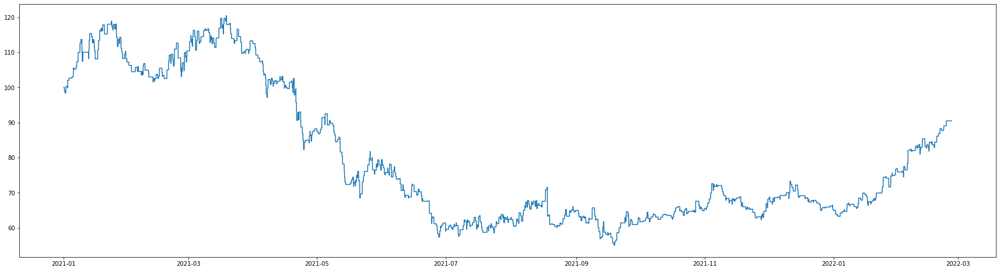

In [18]:
if reinvest_profit_flag == True:
    fig, ax = plt.subplots(figsize=(30, 8))
    ax.plot(budget_dict['time'], budget_dict['budget'])
else:
    print("Not reinvest profit")

In [19]:
if reinvest_profit_flag == True:
    print(f"Max drawdown: {round(max_drawdown * 100, 2)}%")

Max drawdown: 12.11%


In [20]:
win_rate = len(transaction_df[transaction_df['profit'] > 0]) / len(transaction_df)
print(f"Win rate: {round(win_rate * 100, 2)}%")

Win rate: 50.31%


In [21]:
for symbol in transaction_df['symbol'].unique():
    symbol_df = transaction_df[transaction_df['symbol'] == symbol]
    win_rate = len(symbol_df[symbol_df['profit'] > 0]) / len(symbol_df)
    print(f"{symbol} win rate: {round(win_rate * 100, 2)}%")

ETH-PERP win rate: 44.71%
SOL-PERP win rate: 54.79%
LUNA-PERP win rate: 51.64%


In [22]:
print(f"Distribution")
print(pd.DataFrame(transaction_df['profit_percent'].describe()))

Distribution
       profit_percent
count      978.000000
mean         0.007619
std          2.874891
min        -11.807419
25%         -2.048376
50%          0.014510
75%          1.955915
max          4.866907


In [23]:
for symbol in transaction_df['symbol'].unique():
    temp_return = transaction_df[transaction_df['symbol'] == symbol]['profit_percent']
    
    print(f"Distribution {symbol}:")
    print(pd.DataFrame(temp_return.describe()))
    print("\n")

Distribution ETH-PERP:
       profit_percent
count      340.000000
mean        -0.195463
std          2.355350
min         -9.062304
25%         -1.931198
50%         -0.465457
75%          1.390616
max          4.866907


Distribution SOL-PERP:
       profit_percent
count      334.000000
mean         0.069734
std          3.043130
min        -11.298272
25%         -1.986348
50%          0.397964
75%          2.067887
max          4.866907


Distribution LUNA-PERP:
       profit_percent
count      304.000000
mean         0.166507
std          3.192121
min        -11.807419
25%         -2.398369
50%          0.206424
75%          2.896937
max          4.866907




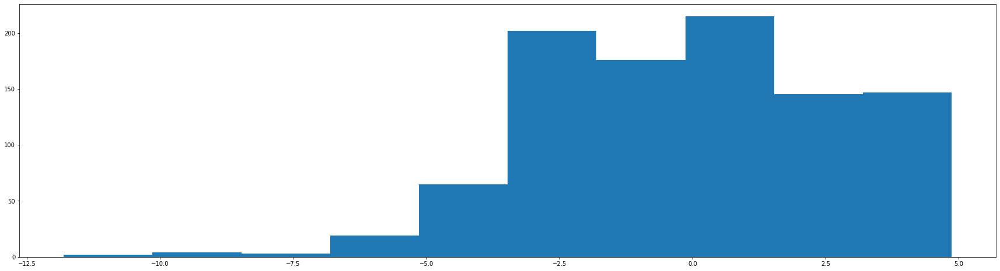

In [24]:
fig, ax = plt.subplots(figsize=(30, 8))
_ = ax.hist(transaction_df['profit_percent'], bins=10)